In [9]:
"""
In this notebook, we will be developing a R-CNN object detection model using Pytorch, and it will be trained on PASCAL VOC Dataset
"""

'\nIn this notebook, we will be developing a R-CNN object detection model using Pytorch, and it will be trained on PASCAL VOC Dataset\n'

#### Installing Kaggle for downloading dataset

In [10]:
# installing kaggle to load pre-processed dataset
!pip install -q kaggle

#### Import Necessary Libraries

In [1]:
import torch
import cv2
import pickle
import os
import numpy as np
import pandas as pd
import torch.nn as nn
import torch.optim as optim
import torchvision
import matplotlib.pyplot as plt
from tqdm import tqdm

#### Loading PASCAL-VOC Dataset

In [2]:
# loading detection data
voc_dataset_train = torchvision.datasets.VOCDetection(root="content/voc",
                                                image_set="train",
                                                download=True,
                                                year="2007")
voc_dataset_val = torchvision.datasets.VOCDetection(root="content/voc",
                                                image_set="val",
                                                download=True,
                                                year="2007")

Using downloaded and verified file: content/voc\VOCtrainval_06-Nov-2007.tar
Extracting content/voc\VOCtrainval_06-Nov-2007.tar to content/voc
Using downloaded and verified file: content/voc\VOCtrainval_06-Nov-2007.tar
Extracting content/voc\VOCtrainval_06-Nov-2007.tar to content/voc


#### Data Exploration

In [13]:
# a sample from the pascal-voc dataset 
exp_samp = voc_dataset_train[0]
print(type(exp_samp))
exp_samp

<class 'tuple'>


(<PIL.Image.Image image mode=RGB size=500x333>,
 {'annotation': {'folder': 'VOC2007',
   'filename': '000012.jpg',
   'source': {'database': 'The VOC2007 Database',
    'annotation': 'PASCAL VOC2007',
    'image': 'flickr',
    'flickrid': '207539885'},
   'owner': {'flickrid': 'KevBow', 'name': '?'},
   'size': {'width': '500', 'height': '333', 'depth': '3'},
   'segmented': '0',
   'object': [{'name': 'car',
     'pose': 'Rear',
     'truncated': '0',
     'difficult': '0',
     'bndbox': {'xmin': '156', 'ymin': '97', 'xmax': '351', 'ymax': '270'}}]}})

We found that the samples of this dataset are in a tuple, where we can find a lot of information regarding the image..

<class 'PIL.Image.Image'>


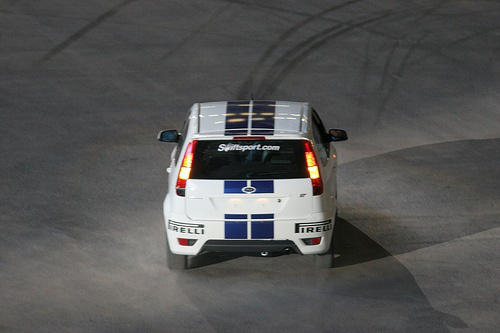

In [14]:
img = exp_samp[0]
print(type(img))
img

In [15]:
print("Sample Image shape: ", np.array(img).shape)

Sample Image shape:  (333, 500, 3)


However, all images are not in the same shape in this dataset. 

In [3]:
"""
Getting the unique object classes in this dataset
"""
all_objs = []
for ds in voc_dataset_train:
    obj_annots = ds[1]["annotation"]["object"]
    for obj in obj_annots:
        all_objs.append(obj["name"])

unique_class_labels = set(all_objs)
print("Number of unique objects in dataset: ", len(unique_class_labels))
print("Unique labels in dataset: \n", unique_class_labels)

Number of unique objects in dataset:  20
Unique labels in dataset: 
 {'boat', 'bottle', 'motorbike', 'diningtable', 'bird', 'horse', 'dog', 'bus', 'aeroplane', 'cow', 'cat', 'person', 'chair', 'bicycle', 'pottedplant', 'tvmonitor', 'car', 'sheep', 'sofa', 'train'}


In [17]:
exp_samp[1]

{'annotation': {'folder': 'VOC2007',
  'filename': '000012.jpg',
  'source': {'database': 'The VOC2007 Database',
   'annotation': 'PASCAL VOC2007',
   'image': 'flickr',
   'flickrid': '207539885'},
  'owner': {'flickrid': 'KevBow', 'name': '?'},
  'size': {'width': '500', 'height': '333', 'depth': '3'},
  'segmented': '0',
  'object': [{'name': 'car',
    'pose': 'Rear',
    'truncated': '0',
    'difficult': '0',
    'bndbox': {'xmin': '156', 'ymin': '97', 'xmax': '351', 'ymax': '270'}}]}}

In [18]:
exp_samp[1]["annotation"]["object"]

[{'name': 'car',
  'pose': 'Rear',
  'truncated': '0',
  'difficult': '0',
  'bndbox': {'xmin': '156', 'ymin': '97', 'xmax': '351', 'ymax': '270'}}]

In [19]:
a = exp_samp[1]["annotation"]["object"]
a

[{'name': 'car',
  'pose': 'Rear',
  'truncated': '0',
  'difficult': '0',
  'bndbox': {'xmin': '156', 'ymin': '97', 'xmax': '351', 'ymax': '270'}}]

In [20]:
a[0]['name']

'car'

#### Necessary functionalities

In [3]:
"""
We create two dictionaries to map objects into class indexes, which is also known for labeling. Each type of objects will have a specific class indexes.
It will be helpful for both training and furthur usage. 
"""

obj_to_idx = {
    'pottedplant': 1, 'person': 2,
    'motorbike': 3, 'train': 4,
    'dog': 5, 'diningtable': 6,
    'horse': 7, 'bus': 8,
    'aeroplane': 9, 'sofa': 10,
    'sheep': 11, 'tvmonitor': 12,
    'bird': 13, 'bottle': 14,
    'chair': 15, 'cat': 16,
    'bicycle': 17, 'cow': 18,
    'boat': 19, 'car': 20, 'bg': 0
}

idx_to_obj = {
    1: 'pottedplant', 2: 'person',
    3: 'motorbike', 4: 'train',
    5: 'dog', 6: 'diningtable',
    7: 'horse', 8: 'bus',
    9: 'aeroplane', 10: 'sofa',
    11: 'sheep', 12: 'tvmonitor',
    13: 'bird', 14: 'bottle',
    15: 'chair', 16: 'cat',
    17: 'bicycle', 18: 'cow',
    19: 'boat', 20: 'car', 0: 'bg'
}


In [3]:
"""
Function to draw bounding boxes over the images. The function has following parameters: 
    img: image as np array
    boxes: [[xmin, y_min, x_max, y_max]]
    labels: labels present in bounding boxes
    scores: array of probabilities that given object is present in bounding boxes.
    class_map: dictionary that maps index to class names
    
"""
 
def draw_boxes(img, boxes, scores, labels, class_map=None):
    nums = len(boxes)
    for i in range(nums):
        x1y1 = tuple((np.array(boxes[i][0:2])).astype(np.int32))
        x2y2 = tuple((np.array(boxes[i][2:4])).astype(np.int32))
        img = cv2.rectangle(img, x1y1, x2y2, (255, 0, 0), 2)
        label = int(labels[i])
        if class_map is not None:
            label_txt = class_map[label]
        else:
            label_txt = str(label)
        img = cv2.putText(
            img,
            "{} {:.4f}".format(label_txt, scores[i]),
            x1y1,
            cv2.FONT_HERSHEY_COMPLEX_SMALL,
            1,
            (0, 0, 255),
            2,
        )
    return img

[[156, 97, 351, 270]]


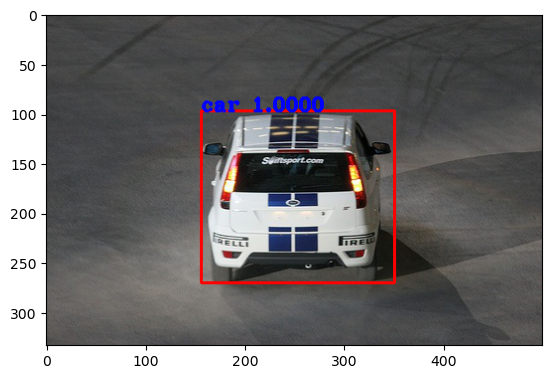

In [6]:
# drawing a bounding boxes over a sample image 

sample_image, sample_annot = voc_dataset_train[0]
sample_image = np.array(sample_image)
sample_annot = sample_annot["annotation"]["object"]
boxes = [[int(v) for k, v in x["bndbox"].items()] for x in sample_annot]
print(boxes)
labels = [obj_to_idx[x["name"]] for x in sample_annot]
scores = [1]*len(labels)
final_image = draw_boxes(sample_image, boxes, scores, labels, idx_to_obj)
plt.imshow(final_image)
plt.show()

In [4]:
# Function to calculate mean Intersection over Union (IoU) Score

def calculate_iou_score_b(box_1, box_2):
    '''
        box_1 = single of ground truth bounding boxes
        box_2 = single of predicted bounded boxes
    '''
    box_1_x1 = box_1[0]
    box_1_y1 = box_1[1]
    box_1_x2 = box_1[2]
    box_1_y2 = box_1[3]

    box_2_x1 = box_2[0]
    box_2_y1 = box_2[1]
    box_2_x2 = box_2[2]
    box_2_y2 = box_2[3]

    x1 = np.maximum(box_1_x1, box_2_x1)
    y1 = np.maximum(box_1_y1, box_2_y1)
    x2 = np.minimum(box_1_x2, box_2_x2)
    y2 = np.minimum(box_1_y2, box_2_y2)

    area_of_intersection = max(0, x2 - x1 + 1) * max(0, y2 - y1 + 1)
    area_box_1 = (box_1_x2 - box_1_x1 + 1) * (box_1_y2 - box_1_y1 + 1)
    area_box_2 = (box_2_x2 - box_2_x1 + 1) * (box_2_y2 - box_2_y1 + 1)
    area_of_union = area_box_1 + area_box_2 - area_of_intersection

    return area_of_intersection/float(area_of_union)

In [7]:
def process_data_for_rcnn(image, rects, class_map, boxes_annots, iou_threshold, max_boxes):
    true_classes = []
    image_sections = []
    true_count = 0
    false_count = 0
    for annot in boxes_annots:
        label = annot["name"]
        box = [int(c) for _, c in annot["bndbox"].items()]
        box = np.array(box)
        for rect in rects:
            iou_score = calculate_iou_score(rect, box)
            if iou_score > iou_threshold:
                if true_count < max_boxes//2:
                    true_classes.append(class_map[label])
                    x1, y1, x2, y2 = rect
                    img_section = image[y1: y2, x1: x2]
                    image_sections.append(img_section)
                    true_count += 1
            else:
                if false_count < max_boxes//2:
                    true_classes.append(0)
                    x1, y1, x2, y2 = rect
                    img_section = image[y1: y2, x1: x2]
                    image_sections.append(img_section)
                    false_count += 1
    return image_sections, true_classes

In [42]:
import os
import shutil

# Define the path to the .kaggle directory in your home directory
kaggle_dir = os.path.join(os.path.expanduser("~"), ".kaggle")

# Create the .kaggle directory if it doesn't exist
if not os.path.exists(kaggle_dir):
    os.makedirs(kaggle_dir)

# Define the path to your kaggle.json file
json_file_path = r"kaggle.json"  # Change this to your actual path

# Copy the kaggle.json to the .kaggle directory
shutil.copy(json_file_path, kaggle_dir)

# Set file permissions (only for Linux/MacOS; this is optional on Windows)
# On Windows, permissions are handled differently, so this line can be skipped if on Windows.
os.chmod(os.path.join(kaggle_dir, "kaggle.json"), 0o600)


In [44]:
# download processed dataset from Kaggle 
!kaggle datasets download -d tarunbisht11/rcnn-processed-pickle

Dataset URL: https://www.kaggle.com/datasets/tarunbisht11/rcnn-processed-pickle
License(s): CC0-1.0




  0%|          | 0.00/4.86G [00:00<?, ?B/s]
  0%|          | 1.00M/4.86G [00:00<1:18:15, 1.11MB/s]
  0%|          | 2.00M/4.86G [00:01<41:28, 2.09MB/s]  
  0%|          | 3.00M/4.86G [00:01<30:04, 2.89MB/s]
  0%|          | 4.00M/4.86G [00:01<24:49, 3.50MB/s]
  0%|          | 5.00M/4.86G [00:01<22:36, 3.84MB/s]
  0%|          | 6.00M/4.86G [00:02<24:21, 3.56MB/s]
  0%|          | 7.00M/4.86G [00:02<20:53, 4.15MB/s]
  0%|          | 8.00M/4.86G [00:02<19:20, 4.48MB/s]
  0%|          | 9.00M/4.86G [00:02<18:13, 4.76MB/s]
  0%|          | 10.0M/4.86G [00:02<17:32, 4.95MB/s]
  0%|          | 11.0M/4.86G [00:03<16:59, 5.10MB/s]
  0%|          | 12.0M/4.86G [00:03<16:32, 5.24MB/s]
  0%|          | 13.0M/4.86G [00:03<17:21, 4.99MB/s]
  0%|          | 14.0M/4.86G [00:03<17:16, 5.02MB/s]
  0%|          | 15.0M/4.86G [00:03<16:52, 5.14MB/s]
  0%|          | 16.0M/4.86G [00:04<17:18, 5.01MB/s]
  0%|          | 17.0M/4.86G [00:04<17:25, 4.97MB/s]
  0%|          | 18.0M/4.86G [00:04<17:29, 4.95MB/

In [9]:
# defining maximum IoU threshold, number of boxes and selections 
max_iou_threshold = 0.7
max_boxes = 50
max_selections = 1000
processed_data_save_path_train = "rcnn-processed-pickle/rcnn_train/rcnn_train"
processed_data_save_path_val = "rcnn-processed-pickle/rcnn_val/rcnn_val"
os.makedirs(processed_data_save_path_train, exist_ok=True)
os.makedirs(processed_data_save_path_val, exist_ok=True)

In [27]:
processed_data_save_path_train = "rcnn-processed-pickle/rcnn_val/rcnn_val"
len(os.listdir(processed_data_save_path_train))


79586

In [ ]:
for i in range(2):
    for image, annote in tqdm(voc_dataset_train):
        image = np.array(image)
        print(image.shape)
        box_annots = annote["annotation"]["object"]
        print(box_annots)

In [ ]:
# dummy
# Training Data Preparation
all_images = []
all_labels = []
all_bbox_targets = []

# Check if the folder is empty
if not os.listdir(processed_bbox_train):  # This checks if the folder is empty
    # Process the images and annotations
    for image, annot in tqdm(voc_dataset_train):
        image = np.array(image)
        boxes_annots = annot["annotation"]["object"]
        ss = cv2.ximgproc.segmentation.createSelectiveSearchSegmentation()
        ss.setBaseImage(image)
        ss.switchToSelectiveSearchFast()
        rects = ss.process()[:max_selections]
        rects = np.array([[x, y, x+w, y+h] for x, y, w, h in rects])
        
        images, classes, bbox_targets = process_data_for_rcnn(image,
                                                               rects,
                                                               obj_to_idx,
                                                               boxes_annots,
                                                               max_iou_threshold,
                                                               max_boxes)
        all_images += images
        all_labels += classes
        all_bbox_targets += bbox_targets

    # Save the processed data to pickle files
    for idx, (image, label, bbox_target) in enumerate(zip(all_images, all_labels, all_bbox_targets)):
        with open(os.path.join(processed_data_save_path_train, f"img_{idx}.pkl"), "wb") as pkl:
            pickle.dump({"image": image, "label": label, "bbox_target": bbox_target}, pkl)

else:
    print("Data Already Prepared.")


In [28]:
# Training Data

all_images = []
all_labels = []
count = 0
if len(os.listdir(processed_data_save_path_train)) < 80000:
    for image, annot in tqdm(voc_dataset_train):
        image = np.array(image)
        boxes_annots = annot["annotation"]["object"]
        ss = cv2.ximgproc.segmentation.createSelectiveSearchSegmentation()
        ss.setBaseImage(image)
        ss.switchToSelectiveSearchFast()
        rects = ss.process()[:max_selections]
        rects = np.array([[x, y, x+w, y+h] for x, y, w, h in rects])
        images, classes = process_data_for_rcnn(image,
                                                rects,
                                                obj_to_idx,
                                                boxes_annots,
                                                max_iou_threshold,
                                                max_boxes)
        count += 1
        all_images += images
        all_labels += classes

    # saving processed data to pickle file
    for idx, (image, label) in enumerate(zip(all_images, all_labels)):
        with open(os.path.join(processed_data_save_path_train, f"img_{idx}.pkl"), "wb") as pkl:
            pickle.dump({"image": image, "label": label}, pkl)
else:
    print("Data Already Prepared.")

100%|██████████| 2501/2501 [31:30<00:00,  1.32it/s]


In [29]:
# Validation Data 

all_images = []
all_labels = []
count = 0
if len(os.listdir(processed_data_save_path_val)) < 80000:
    for image, annot in tqdm(voc_dataset_val):
        image = np.array(image)
        boxes_annots = annot["annotation"]["object"]
        ss = cv2.ximgproc.segmentation.createSelectiveSearchSegmentation()
        ss.setBaseImage(image)
        ss.switchToSelectiveSearchFast()
        rects = ss.process()[:max_selections]
        rects = np.array([[x, y, x+w, y+h] for x, y, w, h in rects])
        images, classes = process_data_for_rcnn(image,
                                                rects,
                                                obj_to_idx,
                                                boxes_annots,
                                                max_iou_threshold,
                                                max_boxes)
        count += 1
        all_images += images
        all_labels += classes

    # saving processed data to pickle file
    for idx, (image, label) in enumerate(zip(all_images, all_labels)):
        with open(os.path.join(processed_data_save_path_val, f"img_{idx}.pkl"), "wb") as pkl:
            pickle.dump({"image": image, "label": label}, pkl)
else:
    print("Data Already Prepared.")

100%|██████████| 2510/2510 [32:16<00:00,  1.30it/s]


In [10]:
#  checking the total samples in both train and validation after applying selective search  
print(f"Total objects in training samples after Selective search: {len(os.listdir(processed_data_save_path_train))}")
print(f"Total objects in validation samples after selectective search: {len(os.listdir(processed_data_save_path_val))}")

Total objects in training samples after Selective search: 79418
Total objects in validation samples after selectective search: 79586


In [11]:
# Defining a custom class to define dataset

class RCNNDataset(torch.utils.data.Dataset):
    def __init__(self, processed_data_folder, section_dim=(224, 224)):
        self.section_dim = section_dim
        self.data_files = os.listdir(processed_data_folder)
        self.data_files = list(map(lambda x: os.path.join(processed_data_folder, x), self.data_files))
        self.preprocess = torchvision.transforms.Normalize([0.485, 0.456, 0.406],
                                                           [0.229, 0.224, 0.225])

    def __len__(self):
        return len(self.data_files)

    def __getitem__(self, idx):
        with open(self.data_files[idx], "rb") as pkl:
            data = pickle.load(pkl)
        image, label = data["image"], data["label"]
        image = cv2.resize(image, self.section_dim)
        image = np.asarray(image, dtype=np.float32)
        image = torch.from_numpy(image)
        image = torch.permute(image, (2, 0, 1))
        image = self.preprocess(image)
        label = torch.tensor(label)
        return image, label

In [12]:
# function to visualize data within a batch 

def imshow(inp, labels, num_rows=2, num_cols=8):
    """Display image for Tensor."""
    fig, axes = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(10, 12))
    axes = axes.ravel()
    mean = torch.tensor([0.485, 0.456, 0.406]).reshape(1, -1, 1, 1)
    std = torch.tensor([0.229, 0.224, 0.225]).reshape(1, -1, 1, 1)
    inp = std * inp + mean
    inp = inp.permute((0, 2, 3, 1))   # Change from (N, C, H, W) to (N, H, W, C)
    inp = inp.type(torch.uint8)
    for idx, ax in enumerate(axes):
        ax.imshow(inp[idx])
        ax.set_title(labels[idx])
        ax.grid(False)
        ax.set_axis_off()
        ax.set_aspect('equal', 'box')
        
    # plt.subplots_adjust(hspace=0.1, wspace=0.2)
    plt.tight_layout()
    plt.show()

In [13]:
# Loading train and validation dataset using our custom dataset class 

train_dataset = RCNNDataset(processed_data_folder=processed_data_save_path_train, section_dim=(224, 224))
val_dataset = RCNNDataset(processed_data_folder=processed_data_save_path_val, section_dim=(224, 224))

print(f"Total samples in the training dataset: {len(train_dataset)}")
print(f"Total samples in the validation dataset: {len(val_dataset)}")

Total samples in the training dataset: 79418
Total samples in the validation dataset: 79586


In [14]:
# more insights into the training samples 
print("Train Dataset one sample images shape: ", train_dataset[0][0].shape)
print("Train Dataset one sample labels shape: ", train_dataset[0][1].shape)
print("Train Dataset one sample images dtype: ", train_dataset[0][0].dtype)
print("Train Dataset one sample labels dtype: ", train_dataset[0][1].dtype)

Train Dataset one sample images shape:  torch.Size([3, 224, 224])
Train Dataset one sample labels shape:  torch.Size([])
Train Dataset one sample images dtype:  torch.float32
Train Dataset one sample labels dtype:  torch.int64


In [15]:
# more insights into the validation samples 
print("Validation Dataset one sample images shape: ", val_dataset[0][0].shape)
print("Validation Dataset one sample labels shape: ", val_dataset[0][1].shape)
print("Validation Dataset one sample images dtype: ", val_dataset[0][0].dtype)
print("Validationrain Dataset one sample labels dtype: ", val_dataset[0][1].dtype)

Validation Dataset one sample images shape:  torch.Size([3, 224, 224])
Validation Dataset one sample labels shape:  torch.Size([])
Validation Dataset one sample images dtype:  torch.float32
Validationrain Dataset one sample labels dtype:  torch.int64


In [16]:
# Now, we will define the data loader for training and validation 
# we have defined batch size 16 here due the the mid size GPU access
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=16, shuffle=True)
val_loader = torch.utils.data.DataLoader(val_dataset, batch_size=16, shuffle=False)

Train Batch


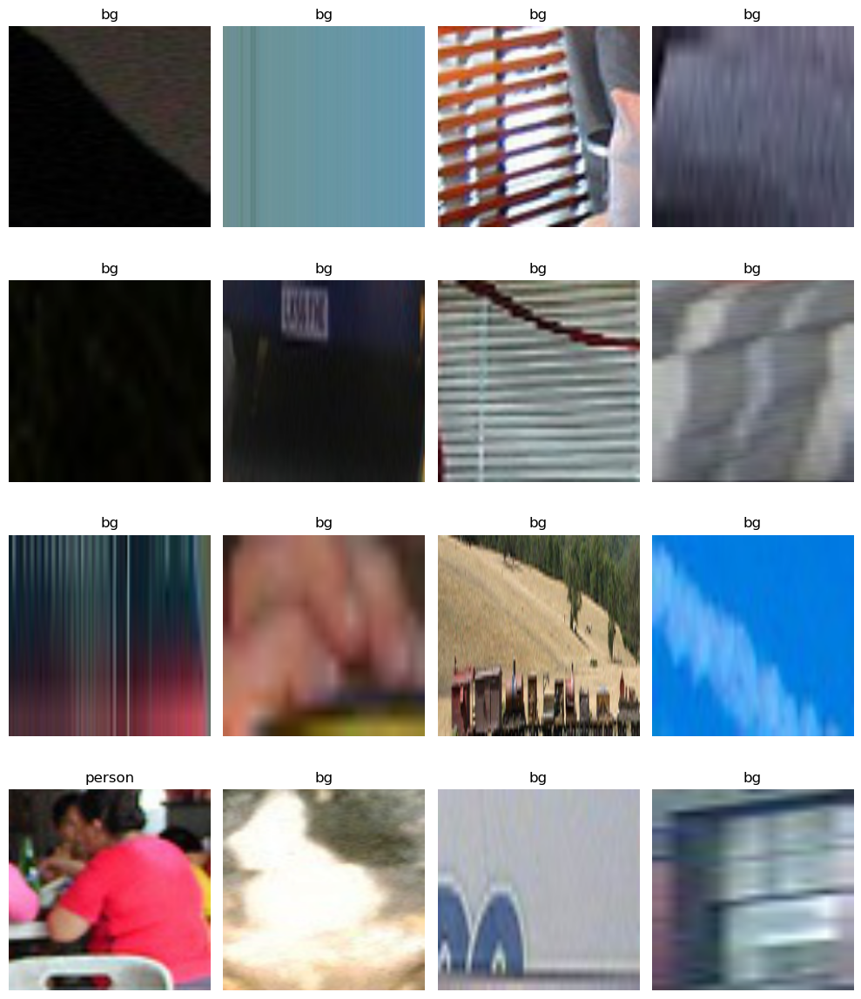

In [63]:
# plotting samples from the train samples 
inputs, labels = next(iter(train_loader))
labels = [idx_to_obj[x.item()] for x in labels]
print("Train Batch")
imshow(inputs, labels, num_rows=4, num_cols=4)

Validation Batch


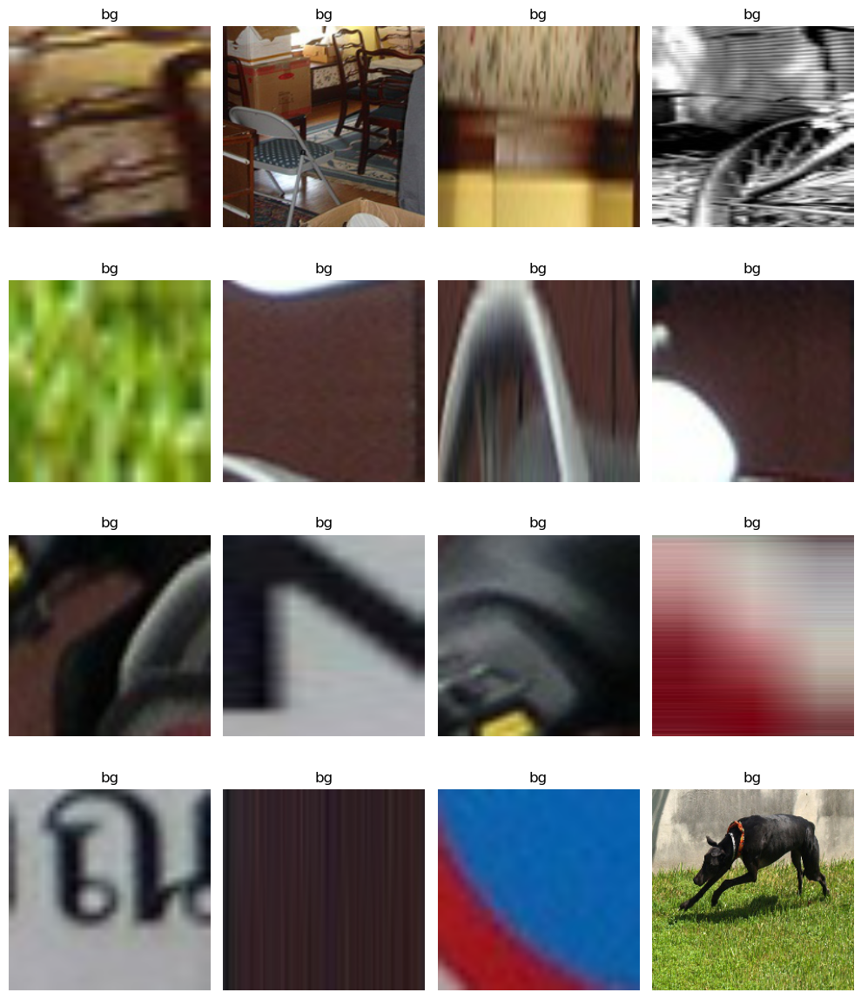

In [66]:
# plotting samples from the train samples 
inputs, labels = next(iter(val_loader))
labels = [idx_to_obj[x.item()] for x in labels]
print("Validation Batch")
imshow(inputs, labels, num_rows=4, num_cols=4)

#### Model Training 

In [9]:
# setting device 
if torch.cuda.is_available():
    device = torch.device("cuda")  # Use GPU
    device_name = torch.cuda.get_device_name(device)  # Get GPU name
else:
    device = torch.device("cpu")  # Use CPU
    device_name = "CPU"  # No GPU, so it's the CPU

print(f"The model will be trained on: {device_name} ({device})"
     )

The model will be trained on: NVIDIA GeForce RTX 3050 (cuda)


Initially, we will train our data with a pretrained Resnet-50 model as pre-training stage, which will help us to perform classfication. In this phase, we will treat these samples objects as classification problems. 

In [10]:
# defining function to build model 

def build_model(backbone, num_classes):
    num_ftrs = backbone.fc.in_features
    # num_classes = number of class categories and +1 for background class
    backbone.fc = nn.Sequential(nn.Dropout(0.25),
                                nn.Linear(num_ftrs, 512),
                                nn.Dropout(0.25),
                                nn.Linear(512, num_classes+1))
    return backbone

In [11]:
# getting pre-trained resnet-50 model 
resnet_backbone = torchvision.models.resnet50(weights='IMAGENET1K_V2')
# freeze pretrained backbone
for param in resnet_backbone.parameters():
    param.requires_grad = False
model = build_model(backbone=resnet_backbone, num_classes=20)
model.to(device)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [21]:
#  we can extract 2048 features from the last conv layer
model.layer4[2]

Bottleneck(
  (conv1): Conv2d(2048, 512, kernel_size=(1, 1), stride=(1, 1), bias=False)
  (bn1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv2): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  (bn2): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv3): Conv2d(512, 2048, kernel_size=(1, 1), stride=(1, 1), bias=False)
  (bn3): BatchNorm2d(2048, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
)

In [75]:
# installing model summay 
!pip install torchsummary

In [77]:
from torchsummary import summary
summary(model, input_size=(3, 224, 224))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 112, 112]           9,408
       BatchNorm2d-2         [-1, 64, 112, 112]             128
              ReLU-3         [-1, 64, 112, 112]               0
         MaxPool2d-4           [-1, 64, 56, 56]               0
            Conv2d-5           [-1, 64, 56, 56]           4,096
       BatchNorm2d-6           [-1, 64, 56, 56]             128
              ReLU-7           [-1, 64, 56, 56]               0
            Conv2d-8           [-1, 64, 56, 56]          36,864
       BatchNorm2d-9           [-1, 64, 56, 56]             128
             ReLU-10           [-1, 64, 56, 56]               0
           Conv2d-11          [-1, 256, 56, 56]          16,384
      BatchNorm2d-12          [-1, 256, 56, 56]             512
           Conv2d-13          [-1, 256, 56, 56]          16,384
      BatchNorm2d-14          [-1, 256,

In [78]:
# defining class weights and parametes 

class_weights = [1.0]+[2.0]*len(unique_class_labels) # 1 for bg and 2 for other classes
class_weights = torch.tensor(class_weights).to(device)
criterion = nn.CrossEntropyLoss(weight=class_weights)
optimizer = optim.Adam(model.parameters(), lr=1e-4)

In [79]:
#  model training 

torch.cuda.empty_cache()
num_epochs = 100
best_val_loss = 1000
epoch_train_losses = []
epoch_val_losses = []
train_accuracy = []
val_accuracy = []
count = 0
for idx in range(num_epochs):
    train_losses = []
    total_train = 0
    correct_train = 0
    model.train()
    for images, labels in tqdm(train_loader):
        optimizer.zero_grad()
        images = images.to(device)
        labels = labels.to(device)
        pred = model(images)
        loss = criterion(pred, labels)
        predicted = torch.argmax(pred, 1)
        total_train += labels.shape[0]
        correct_train += (predicted == labels).sum().item()
        loss.backward()
        optimizer.step()
        train_losses.append(loss.item())
    accuracy_train = (100 * correct_train) / total_train
    train_accuracy.append(accuracy_train)
    epoch_train_loss = np.mean(train_losses)
    epoch_train_losses.append(epoch_train_loss)

    val_losses = []
    total_val = 0
    correct_val = 0
    model.eval()
    with torch.no_grad():
        for images, labels in tqdm(val_loader):
            images = images.to(device)
            labels = labels.to(device)
            pred = model(images)
            loss = criterion(pred, labels)
            val_losses.append(loss.item())
            predicted = torch.argmax(pred, 1)
            total_val += labels.shape[0]
            correct_val += (predicted == labels).sum().item()

    accuracy_val = (100 * correct_val) / total_val
    val_accuracy.append(accuracy_val)
    epoch_val_loss = np.mean(val_losses)
    epoch_val_losses.append(epoch_val_loss)

    print('\nEpoch: {}/{}, Train Loss: {:.6f}, Train Accuracy: {:.6f}, Val Loss: {:.6f}, Val Accuracy: {:.6f}'.format(idx + 1, num_epochs, epoch_train_loss, accuracy_train, epoch_val_loss, accuracy_val))


    if epoch_val_loss < best_val_loss:
        best_val_loss = epoch_val_loss
        print("Saving the model state dictionary for Epoch: {} with Validation loss: {:.6f}".format(idx + 1, epoch_val_loss))
        torch.save(model.state_dict(), "rcnn_resnet_50_backbone.pt")
        count = 0
    else:
        count += 1

    if count == 5:
        break

100%|██████████| 4975/4975 [05:45<00:00, 14.39it/s]



Epoch: 1/100, Train Loss: 0.606245, Train Accuracy: 87.751615, Val Loss: 0.388002, Val Accuracy: 90.536024
Saving the model state dictionary for Epoch: 1 with Validation loss: 0.388002


100%|██████████| 4975/4975 [05:47<00:00, 14.32it/s]



Epoch: 2/100, Train Loss: 0.421470, Train Accuracy: 90.111326, Val Loss: 0.306610, Val Accuracy: 92.052622
Saving the model state dictionary for Epoch: 2 with Validation loss: 0.306610


100%|██████████| 4975/4975 [05:50<00:00, 14.21it/s]



Epoch: 3/100, Train Loss: 0.381020, Train Accuracy: 90.656648, Val Loss: 0.262530, Val Accuracy: 92.709773
Saving the model state dictionary for Epoch: 3 with Validation loss: 0.262530


100%|██████████| 4975/4975 [05:53<00:00, 14.07it/s]



Epoch: 4/100, Train Loss: 0.364970, Train Accuracy: 91.019777, Val Loss: 0.363807, Val Accuracy: 92.596688


100%|██████████| 4975/4975 [05:57<00:00, 13.93it/s]



Epoch: 5/100, Train Loss: 0.350380, Train Accuracy: 91.129093, Val Loss: 0.409312, Val Accuracy: 91.841530


100%|██████████| 4975/4975 [05:55<00:00, 14.00it/s]



Epoch: 6/100, Train Loss: 0.338640, Train Accuracy: 91.527404, Val Loss: 0.448873, Val Accuracy: 92.934687


100%|██████████| 4975/4975 [06:01<00:00, 13.78it/s]



Epoch: 7/100, Train Loss: 0.331263, Train Accuracy: 91.741010, Val Loss: 0.221939, Val Accuracy: 93.581786
Saving the model state dictionary for Epoch: 7 with Validation loss: 0.221939


100%|██████████| 4975/4975 [06:14<00:00, 13.29it/s]



Epoch: 8/100, Train Loss: 0.329858, Train Accuracy: 91.533687, Val Loss: 0.304179, Val Accuracy: 93.261378


100%|██████████| 4975/4975 [06:11<00:00, 13.38it/s]



Epoch: 9/100, Train Loss: 0.321051, Train Accuracy: 91.772422, Val Loss: 0.229380, Val Accuracy: 93.605659


100%|██████████| 4975/4975 [06:28<00:00, 12.79it/s]  



Epoch: 10/100, Train Loss: 0.316357, Train Accuracy: 91.805091, Val Loss: 0.411599, Val Accuracy: 93.555399


100%|██████████| 4975/4975 [06:46<00:00, 12.23it/s]



Epoch: 11/100, Train Loss: 0.315710, Train Accuracy: 91.857864, Val Loss: 0.279673, Val Accuracy: 93.534039


100%|██████████| 4975/4975 [07:29<00:00, 11.08it/s]


Epoch: 12/100, Train Loss: 0.315191, Train Accuracy: 91.864147, Val Loss: 0.294061, Val Accuracy: 93.784083


In [81]:
if torch.cuda.is_available():
    print("GPU")
else:
    print("CPU")

GPU


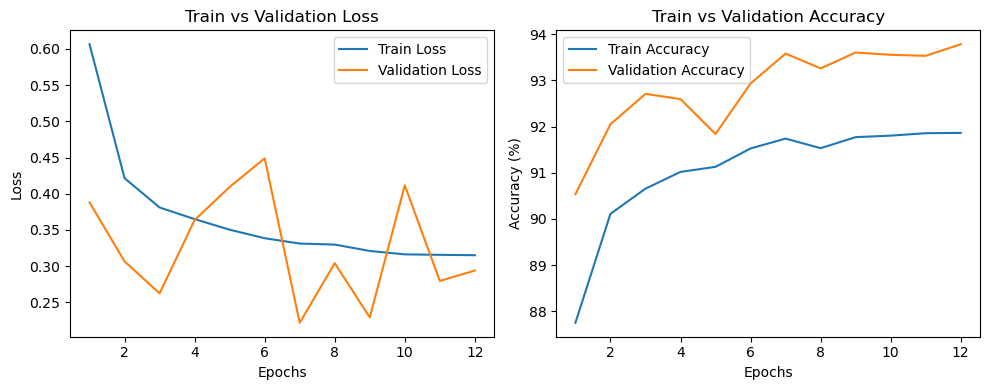

In [89]:
# Plotting the training and validation loss curves and training accuracy curves 
num_epochs = 12
plt.figure(figsize=(10, 4))

# Loss Plot
plt.subplot(1, 2, 1)
plt.plot(range(1, num_epochs + 1), epoch_train_losses, label='Train Loss')
plt.plot(range(1, num_epochs + 1), epoch_val_losses, label='Validation Loss')
plt.title('Train vs Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

# Accuracy Plot
plt.subplot(1, 2, 2)
plt.plot(range(1, num_epochs + 1), train_accuracy, label='Train Accuracy')
plt.plot(range(1, num_epochs + 1), val_accuracy, label='Validation Accuracy')
plt.title('Train vs Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy (%)')
plt.legend()

plt.tight_layout()  # Adjust layout for better spacing
plt.show()

In [90]:
normalized_transform = torchvision.transforms.Normalize([0.485, 0.456, 0.406],
                                                        [0.229, 0.224, 0.225])
def process_inputs(image, max_selections=300, section_size=(224, 224)):
    images = []
    boxes = []
    ss = cv2.ximgproc.segmentation.createSelectiveSearchSegmentation()
    ss.setBaseImage(image)
    ss.switchToSelectiveSearchQuality()
    rects = ss.process()[:max_selections]
    rects = np.array([[x, y, x+w, y+h] for x, y, w, h in rects])
    for rect in rects:
        x1, y1, x2, y2 = rect
        img_section = image[y1: y2, x1: x2]
        img_section = cv2.resize(img_section, section_size)
        images.append(img_section)
        boxes.append(rect)
    images = np.array(images, dtype=np.float32)
    images = torch.from_numpy(images)
    images = images.permute(0, 3, 1, 2)
    images = normalized_transform(images)
    return images, np.array(boxes)

In [91]:
def non_max_supression(boxes, scores, labels, threshold=0.5, iou_threshold=0.5):
    idxs = np.where(scores>threshold)  # taking those indexes that have probabilities > the threshold
    boxes = boxes[idxs]   # selecting those boxes for which the model's confidence score is higher than threshold
    scores = scores[idxs] # seleting those scores that is higher than threshold ~ 0.5
    labels = labels[idxs] # selecting the labels for selected proposed regions 
    idxs = np.argsort(scores) # sorting the array in ascending order
    chossen_boxes = [] 
    choosen_boxes_scores = []
    choosen_boxes_labels = []
    while len(idxs):
        last = len(idxs) - 1
        choosen_idx = idxs[last]   # determining an index from a specific prediction that meets the threshold requirements
        choosen_box = boxes[choosen_idx]  # taking a specific box from the selected boxes
        choosen_box_score = scores[choosen_idx] # getting the score of the choosen box
        choosen_box_label = labels[choosen_idx] # getting the label of the choosen box
        chossen_boxes.append(choosen_box)  # add this box into the choosen boxes list
        choosen_boxes_scores.append(choosen_box_score)
        choosen_boxes_labels.append(choosen_box_label)
        idxs = np.delete(idxs, last)
        i = len(idxs)-1
        while i >= 0:
            idx = idxs[i]
            curr_box = boxes[idx]
            curr_box_score = scores[idx]
            curr_box_label = labels[idx]
            if (curr_box_label == choosen_box_label and
                calculate_iou_score(curr_box, choosen_box) > iou_threshold):
                idxs = np.delete(idxs, i)
            i -= 1
    return chossen_boxes, choosen_boxes_scores, choosen_boxes_labels

In [92]:
# function to process output 
def process_outputs(scores, boxes, threshold=0.5, iou_threshold=0.5):
    labels = np.argmax(scores, axis=1)
    probas = np.max(scores, axis=1)
    idxs = labels != 0
    boxes = boxes[idxs]
    probas = probas[idxs]
    labels = labels[idxs]
    assert len(probas) == len(boxes) == len(labels)
    final_boxes, final_boxes_scores, final_boxes_labels = non_max_supression(boxes, probas, labels, threshold, iou_threshold)
    return final_boxes, final_boxes_scores, final_boxes_labels

#### Test Model

In [93]:
# loading best model
model.load_state_dict(torch.load("rcnn_resnet_50_backbone.pt"))

C:\Users\AI\AppData\Local\Temp\ipykernel_15036\3057596461.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load("rcnn_resnet_50_backbone.pt"))

<All keys matched successfully>

In [94]:
# load a validation image
val_image = np.array(voc_dataset_val[0][0])
# preprocess input image
prep_val_images, prep_val_boxes = process_inputs(val_image)
prep_val_images.shape, prep_val_images.dtype, prep_val_boxes.shape, prep_val_boxes.dtype

(torch.Size([300, 3, 224, 224]), torch.float32, (300, 4), dtype('int32'))

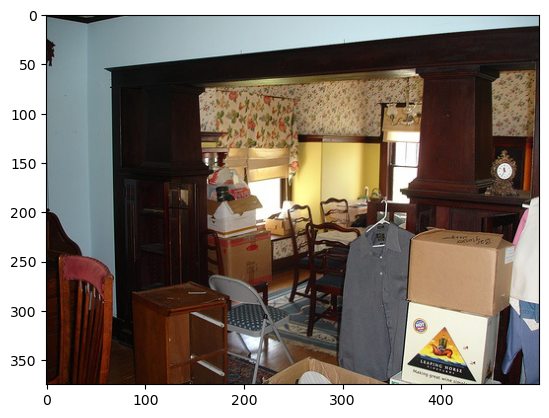

In [96]:
plt.imshow(val_image)
plt.show()

In [95]:
model.eval()
with torch.no_grad():
    output = model(prep_val_images.to(device))
# postprocess output from model
scores = torch.softmax(output, dim=1).cpu().numpy()
print(f"Total scores: {scores.shape}")
boxes, boxes_scores, boxes_labels = process_outputs(scores, prep_val_boxes, threshold=0.5, iou_threshold=0.5)

Total scores: (300, 21)


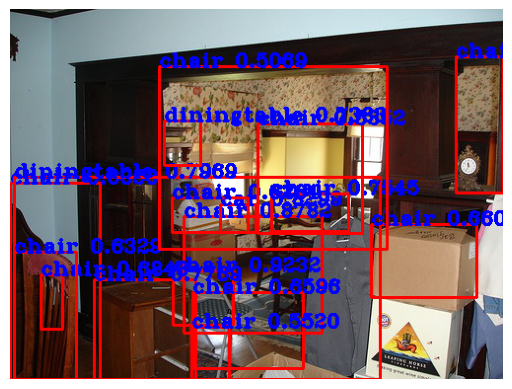

In [97]:
final_image = draw_boxes(val_image,
                         boxes,
                         boxes_scores,
                         boxes_labels,
                         idx_to_obj)
plt.axis("off")
plt.imshow(final_image)
plt.show()

In [118]:
#  putting altogether to create a prediction function 

def predict(image, only_boxed_image=False, label_map=None, max_boxes=100, threshold=0.5, iou_threshold=0.5):
    # preprocess input image
    prep_val_images, prep_val_boxes = process_inputs(image, max_selections=max_boxes)
    model.eval()
    with torch.no_grad():
        output = model(prep_val_images.to(device))
    # postprocess output from model
    scores = torch.softmax(output, dim=1).cpu().numpy()
    boxes, boxes_scores, boxes_labels = process_outputs(scores,
                                                        prep_val_boxes,
                                                        threshold=threshold,
                                                        iou_threshold=iou_threshold)
    if only_boxed_image:
        box_image = draw_boxes(image, boxes, boxes_scores, boxes_labels, label_map)
        return box_image
    return boxes, boxes_scores, boxes_labels

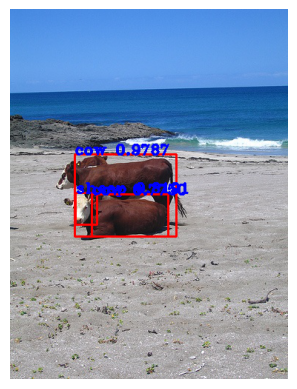

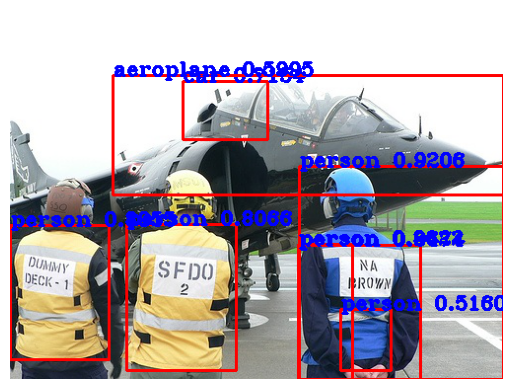

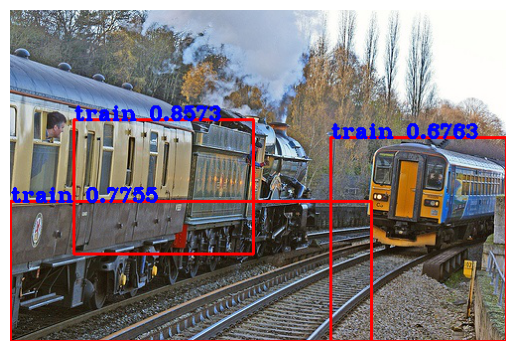

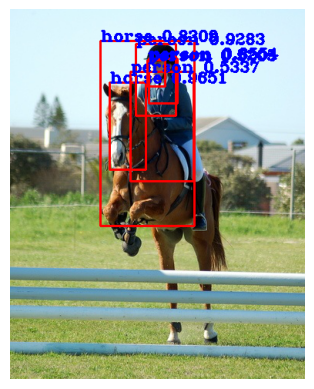

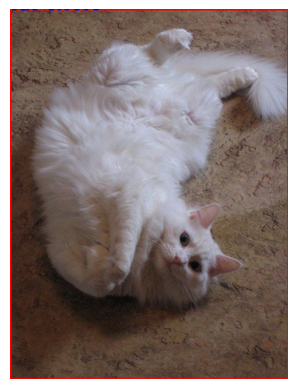

...

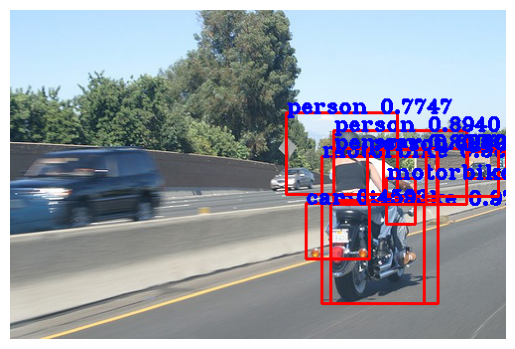

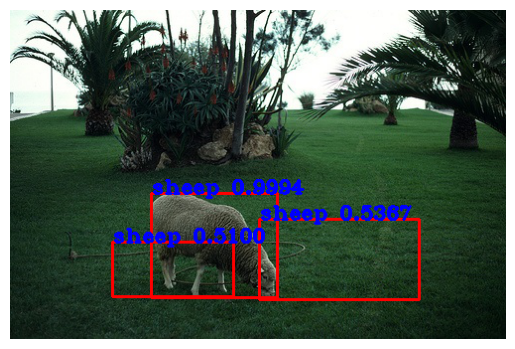

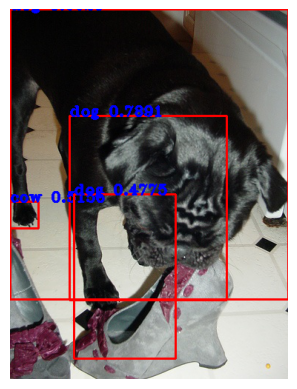

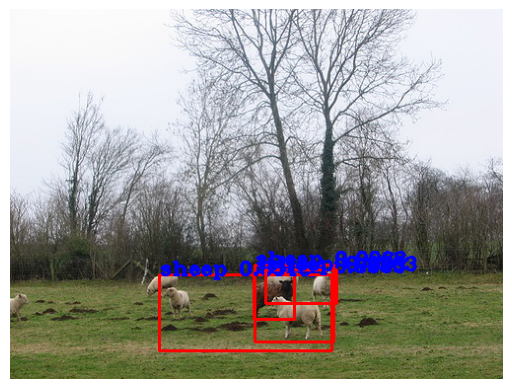

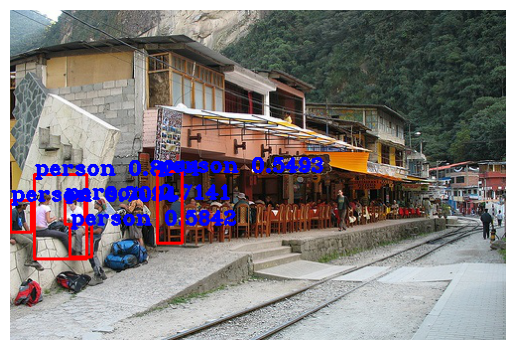

In [122]:
for i in range(120,150):
    image = np.array(voc_dataset_val[i][0])
    final_image = predict(image, only_boxed_image=True,
                          label_map=idx_to_obj,
                          threshold=0.4, iou_threshold=0.55)
    plt.axis("off")
    plt.imshow(final_image)
    plt.show()

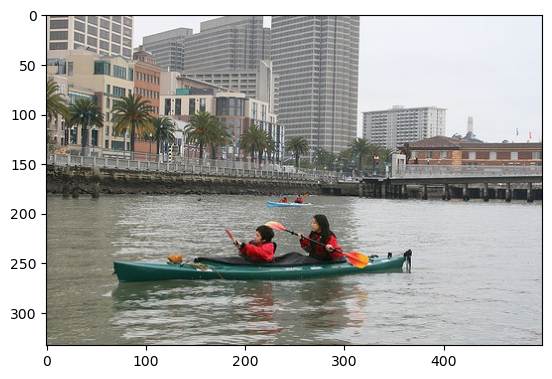

In [124]:
# Another sample 
image = np.array(voc_dataset_val[786][0])
plt.imshow(image)
plt.show()

In [125]:
prep_val_images, prep_val_boxes = process_inputs(image, max_selections=max_boxes)
model.eval()
with torch.no_grad():
    output = model(prep_val_images.to(device))

In [126]:
# postprocess output from model
scores = torch.softmax(output, dim=1).cpu().numpy()

#### Feature Extraction and SVM Classification

In [22]:
# loading best model
model.load_state_dict(torch.load("rcnn_resnet_50_backbone.pt"))

C:\Users\AI\AppData\Local\Temp\ipykernel_5424\3057596461.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load("rcnn_resnet_50_backbone.pt"))


<All keys matched successfully>

In [23]:
# we will extract features from the last conv layer to train these with SVM
model.layer4[2]

Bottleneck(
  (conv1): Conv2d(2048, 512, kernel_size=(1, 1), stride=(1, 1), bias=False)
  (bn1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv2): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  (bn2): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv3): Conv2d(512, 2048, kernel_size=(1, 1), stride=(1, 1), bias=False)
  (bn3): BatchNorm2d(2048, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
)

In [24]:
# defining a hook function to get the features from intermediate layers 
def hook_fn(module, input, output):
    """This function is called when the forward pass of the hooked layer is executed.
    It saves the output (features) in a list."""
    features.append(output)

In [25]:
# registering hook to get the features from last conv layer
features = []
hook = model.layer4[2].register_forward_hook(hook_fn)

In [28]:
# Now, checking this with a dummy sample
input_tensor = torch.randn(1, 3, 224, 224)
input_tensor = input_tensor.to(device) 

# Forward pass to get the features
model.eval() 
with torch.no_grad():
    output = model(input_tensor)

# Print the shape of the features to verify it
print(features[0].shape)  # Should print: torch.Size([1, 2048, 1, 1])

#After extracting the features, remove the hook
hook.remove()

torch.Size([1, 2048, 7, 7])


The last conv layer producing 2048x7x7 feature maps for each samples, which is around 100352 features in total. We will not use that much features to train with SVM classifier. The original paper utilizes 4096 features during the extraction, we will utilize half of them ~ 2048 for each sample. From the model architecture, if we take features from the average pooling layer, it will provide us 2048 features. Therefore, we will utilize hook on the average pooling layer. 

In [36]:
def hooked_feat(model, input, output):
    features.append(output)


In [35]:
features = []

hook_ft = model.avgpool.register_forward_hook(hooked_feat)

# Forward pass to get the features
model.eval() 
with torch.no_grad():
    output = model(input_tensor)

# Print the shape of the features to verify it
print(features[0].shape)  # Should print: torch.Size([1, 2048, 1, 1])

#After extracting the features, remove the hook
hook_ft.remove()

torch.Size([1, 2048, 1, 1])


##### Feature Extraction

In [ ]:
# from training dataset
all_features = []
all_labels = []

model.eval()

with torch.no_grad():
    for batch_idx, (inputs, labels) in enumerate(train_loader):
        # Move inputs and labels to the same device as the model (GPU or CPU)
        inputs = inputs.to(device)
        labels = labels.to(device)
        
        # Pass the input through the model
        model(inputs)

        # Get the 2048-dimensional features (from the AdaptiveAvgPool2d layer)
        extracted_features = features[-1] 

        # Reshape the features: Convert from (batch_size, 2048, 1, 1) to (batch_size, 2048)
        extracted_features = extracted_features.view(extracted_features.size(0), -1)

        # Append the features to the all_features list
        all_features.append(extracted_features.cpu().numpy())  # Move features back to CPU and convert to numpy

        # Store labels
        all_labels.append(labels.cpu().numpy())

        # Print batch progress
        print(f"Processed batch {batch_idx + 1}/{len(train_loader)}")

# Remove the hook after feature extraction is complete
hook.remove()

In [50]:
# checking the shape of all features and labels
print(f"Shape after feature extraction: {all_features[1].shape}")
print(f"Labels shape: {all_labels[1].shape}")

Shape after feature extraction: (16, 2048)
Labels shape: (16,)


In [51]:
print(len(all_features))

4964


In [52]:
# concatenate features from all batches to represent as a dataset
all_features = np.concatenate(all_features, axis=0)
all_labels = np.concatenate(all_labels, axis = 0)


Samples shape after concatenation: [[0.         0.         0.01361132 ... 0.11384097 0.01890143 0.        ]
 [0.00168976 1.6388736  0.         ... 0.         0.21523145 0.        ]
 [0.00247647 0.         0.         ... 0.         0.         0.01346098]
 ...
 [0.06504775 0.05202499 0.08482566 ... 0.08332562 0.         0.02484588]
 [0.07814953 0.40234882 0.         ... 0.00761857 0.         0.        ]
 [0.02090858 0.         0.4014396  ... 0.15339144 0.03221115 0.        ]]
Labels shape after concatenation: [ 0  0  0 ... 16  0  0]


In [54]:
print(f"Samples shape after concatenation: {all_features.shape}")
print(f"Labels shape after concatenation: {all_labels.shape}")

Samples shape after concatenation: (79418, 2048)
Labels shape after concatenation: (79418,)


In [55]:
# now, we will store these extracted features and labels in a csv file for further usage 
# Features are in the columns and labels are in the last column
feature_columns = [f'feature_{i}' for i in range(all_features.shape[1])]  # Create feature column names
columns = feature_columns + ['label']  # Add 'label' column to the end

# Create a DataFrame
df = pd.DataFrame(np.hstack([all_features, all_labels.reshape(-1, 1)]), columns=columns)

# save as CSV
df.to_csv("train_features_labels.csv", index=False)

In [56]:
# check the dataframe 
df.head(5)

,feature_0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,...,feature_2039,feature_2040,feature_2041,feature_2042,feature_2043,feature_2044,feature_2045,feature_2046,feature_2047,label
0,0.000000,0.000000,0.013611,0.000000,0.101158,0.107799,0.056046,0.125168,0.025265,0.015485,...,0.000000,0.577335,0.023031,0.000000,0.068077,0.000000,0.113841,0.018901,0.000000,0.0
1,0.001690,1.638874,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.004019,0.000000,...,0.001791,0.000000,0.000000,0.000000,0.019786,0.000000,0.000000,0.215231,0.000000,0.0
2,0.002476,0.000000,0.000000,0.013146,0.012731,0.015654,0.085575,0.000000,0.250368,0.076567,...,0.000000,0.013079,0.000571,0.592993,0.458835,0.190075,0.000000,0.000000,0.013461,0.0
3,0.000000,0.000000,0.000000,0.000000,0.004611,0.000000,0.000000,0.000000,0.002853,0.000000,...,0.000000,0.000000,0.032021,0.000000,0.154736,0.000000,0.000000,0.000000,0.005101,0.0
4,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.016897,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0


In [57]:
#  Now we will also extract features from validation set to evaluate with SVM 
# from training dataset
all_features = []
all_labels = []

model.eval()

with torch.no_grad():
    for batch_idx, (inputs, labels) in enumerate(val_loader):
        # Move inputs and labels to the same device as the model (GPU or CPU)
        inputs = inputs.to(device)
        labels = labels.to(device)
        
        # Pass the input through the model
        model(inputs)

        # Get the 2048-dimensional features (from the AdaptiveAvgPool2d layer)
        extracted_features = features[-1] 

        # Reshape the features: Convert from (batch_size, 2048, 1, 1) to (batch_size, 2048)
        extracted_features = extracted_features.view(extracted_features.size(0), -1)

        # Append the features to the all_features list
        all_features.append(extracted_features.cpu().numpy())  # Move features back to CPU and convert to numpy

        # Store labels
        all_labels.append(labels.cpu().numpy())


# Remove the hook after feature extraction is complete
hook.remove()

In [58]:
# checking the shape of all features and labels
print(f"Shape after feature extraction: {all_features[1].shape}")
print(f"Labels shape: {all_labels[1].shape}")

# concatenate features from all batches to represent as a dataset
all_features = np.concatenate(all_features, axis=0)
all_labels = np.concatenate(all_labels, axis = 0)

print(f"Samples shape after concatenation: {all_features.shape}")
print(f"Labels shape after concatenation: {all_labels.shape}")

Shape after feature extraction: (16, 2048)
Labels shape: (16,)
Samples shape after concatenation: (79586, 2048)
Labels shape after concatenation: (79586,)


In [59]:
# Features are in the columns and labels are in the last column
feature_columns = [f'feature_{i}' for i in range(all_features.shape[1])]  # Create feature column names
columns = feature_columns + ['label']  # Add 'label' column to the end

# Create a DataFrame
df = pd.DataFrame(np.hstack([all_features, all_labels.reshape(-1, 1)]), columns=columns)

# save as CSV
df.to_csv("validation_features_labels.csv", index=False)

In [60]:
df.head(5)

,feature_0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,...,feature_2039,feature_2040,feature_2041,feature_2042,feature_2043,feature_2044,feature_2045,feature_2046,feature_2047,label
0,0.000000,0.290236,0.000000,0.081846,0.000000,0.000000,0.000000,0.023552,0.000000,0.000000,...,0.943391,0.233497,0.016850,0.106277,0.357997,0.000000,0.039563,0.000000,0.000000,0.0
1,0.509575,0.000000,0.027876,0.039311,0.036560,0.145501,0.006629,0.004196,0.000000,0.029064,...,0.000000,0.000000,0.011381,0.000000,0.016968,0.000000,0.004009,0.018664,0.007856,0.0
2,0.000000,0.000000,0.174270,0.012884,0.000000,0.039526,0.102631,0.036939,0.370545,0.020557,...,0.000000,0.048724,0.111628,0.433918,0.011988,0.064456,0.012760,0.000000,0.030014,0.0
3,0.076448,0.024011,0.152377,0.213337,0.116577,0.000000,0.161335,0.059211,0.000000,0.215998,...,1.134182,0.003296,0.047952,0.009331,0.050804,0.259071,0.000000,0.609873,0.102590,0.0
4,0.000000,0.405678,0.133663,0.000000,0.000000,0.000000,0.018566,0.000000,0.203764,0.000000,...,0.000000,0.013028,0.275129,0.000000,0.056645,0.000000,0.000000,0.122915,0.000000,0.0


In [61]:
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score
import os
import joblib  # For saving/loading the model

class SVMClassifier:
    def __init__(self, train_data, test_size=0.2, val_data=None, random_state=42, model_save_path=None):
        """
        Initialize SVM Classifier with train and validation data.
        
        Parameters:
        - train_data: csv file or N-dimensional numpy array containing training features.
        - val_data: csv file or N-dimensional numpy array containing validation features.
        - test_size: Fraction of the dataset to be used as test data (used only if val_data is not provided).
        - random_state: Random seed for reproducibility.
        - model_save_path: File path to save the trained model (optional).
        """
        self.test_size = test_size
        self.random_state = random_state
        self.model_save_path = model_save_path
        self.model = None
        self.clf = None

        # Load training data
        self.load_data(train_data, 'train')

        # If validation data is provided, load it
        if val_data is not None:
            self.load_data(val_data, 'val')
        else:
            # If no validation data is provided, split the training data into train/val
            self.X_train, self.X_val, self.y_train, self.y_val = train_test_split(
                self.X_train, self.y_train, test_size=self.test_size, random_state=self.random_state
            )
        
    def load_data(self, data, data_type='train'):
        """
        Loads the data (either from CSV file or NumPy array) and splits it into features and labels.
        
        Parameters:
        - data: Path to the CSV file or NumPy array with features and labels.
        - data_type: Type of data ('train' or 'val').
        """
        if isinstance(data, str):
            # Check if it's a CSV file
            if os.path.splitext(data)[-1].lower() == '.csv':
                df = pd.read_csv(data)
                X = df.drop('label', axis=1).values  # Features (drop the label column)
                y = df['label'].values  # Labels
            else:
                raise ValueError("The provided file is not a CSV file.")
        elif isinstance(data, np.ndarray):
            if data.ndim != 2:
                raise ValueError("The input NumPy array must be 2D with shape (n_samples, n_features+1)")
            X = data[:, :-1]  # Features (all columns except the last)
            y = data[:, -1]   # Labels (last column)
        else:
            raise ValueError("The input data must be either a CSV file path or a NumPy array.")

        # Store the loaded data based on the data_type ('train' or 'val')
        if data_type == 'train':
            self.X_train = X
            self.y_train = y
        elif data_type == 'val':
            self.X_val = X
            self.y_val = y

    def train(self, C=1.0, kernel='linear', gamma='scale'):
        """
        Trains the SVM classifier on the training data.
        
        Parameters:
        - C: Regularization parameter. The strength of the regularization is inversely proportional to C.
        - kernel: Specifies the kernel type to be used in the algorithm.
        - gamma: Kernel coefficient for 'rbf', 'poly', and 'sigmoid'.
        
        Returns:
        - Trained model (SVM classifier).
        """
        # Initialize the SVM model with the given hyperparameters
        self.clf = SVC(C=C, kernel=kernel, gamma=gamma, random_state=self.random_state)

        # Train the model
        self.clf.fit(self.X_train, self.y_train)

        # If model_save_path is provided, save the trained model
        if self.model_save_path:
            joblib.dump(self.clf, self.model_save_path)
            print(f"Model saved to {self.model_save_path}")

        # Return the trained model for further usage
        return self.clf

    def evaluate(self):
        """
        Evaluates the trained SVM classifier on both training and validation sets.
        """
        if self.clf is None:
            raise ValueError("Model has not been trained. Call 'train()' first.")
        
        # Training accuracy
        train_pred = self.clf.predict(self.X_train)
        train_acc = accuracy_score(self.y_train, train_pred)
        print(f"Training Accuracy: {train_acc:.4f}")
        
        # Validation accuracy
        val_pred = self.clf.predict(self.X_val)
        val_acc = accuracy_score(self.y_val, val_pred)
        print(f"Validation Accuracy: {val_acc:.4f}")

    def predict(self, X_new):
        """
        Predicts the class labels for new data (after training).
        
        Parameters:
        - X_new: New data to predict class labels for.
        
        Returns:
        - predictions: Predicted class labels.
        """
        if self.clf is None:
            raise ValueError("Model has not been trained. Call 'train()' first.")
        
        # Predict using the trained model
        return self.clf.predict(X_new)

    def load_model(self, model_path):
        """
        Loads a previously saved model.
        
        Parameters:
        - model_path: Path to the saved model.
        
        Returns:
        - Loaded model (SVM classifier).
        """
        self.clf = joblib.load(model_path)
        print(f"Model loaded from {model_path}")
        return self.clf

In [62]:
train_csv_file = 'train_features_labels.csv'  # Adjust this to the path of your train CSV file
val_csv_file = 'validation_features_labels.csv'  # Adjust this to the path of your validation CSV file

# Instantiate and train SVM model
svm_classifier = SVMClassifier(train_data=train_csv_file, val_data=val_csv_file, model_save_path="svm_model.pkl")
trained_svm = svm_classifier.train(C=1.0, kernel='linear', gamma='scale')
    
# Evaluate the model
svm_classifier.evaluate()

Model saved to svm_model.pkl
Training Accuracy: 0.9913
Validation Accuracy: 0.8834


In [65]:
# classification with SVM
from PIL import Image
# all of these images are apart from the pascal voc dataset
folder_path = r"C:\Users\AI\Desktop\Tarek\demos"
def load_images_from_folder(folder):
    image_paths = [os.path.join(folder, filename) for filename in os.listdir(folder) if filename.endswith(('jpg', 'jpeg', 'png'))]
    images = []
    for image_path in image_paths:
        img = Image.open(image_path).convert('RGB')  # Open image and convert to RGB
        images.append(img)
    return images, image_paths

In [66]:
images, image_paths = load_images_from_folder(folder_path)
print(len(images))

6


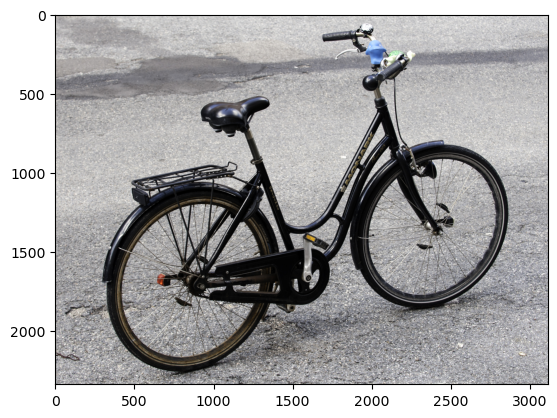

In [69]:
img_1 = images[1]
plt.imshow(img_1)
plt.show()

In [76]:
# Image transformation to convert to tensor (assuming model expects resized images)
from torchvision import transforms
transform = transforms.Compose([
    transforms.Resize((224, 224)),  # Resize images to the input size of the model (e.g., 224x224 for ResNet)
    transforms.ToTensor(),  # Convert image to PyTorch tensor
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Normalize (assuming pre-trained model)
])

# Function to convert images into tensors
def image_to_tensors(image):
    tensor_image = transform(image)
    tensor_image = tensor_image.unsqueeze(0)
    return tensor_image  

In [102]:
 # converting the demo image into tensor
img_t = image_to_tensors(img_1)
print(f"Shape after converting the input image into tensor: {img_t.shape}")

# getting 2024 features and prediction output from the CNN model
features = []
model.eval()
with torch.no_grad():
    output = model(img_t.to(device))

print(f"Prediction by CNN: {output}")
pred = torch.argmax(output)
pred = int(pred.cpu())
print(f"Max probability index: {pred}")
print(f"Predicted class by CNN: {idx_to_obj[pred]}")

# now GETTNING THE FEATURES
print(f"\nShape after hook: {features[0].shape}")
img_feat = features[0].view(features[0].size(0), -1)
img_np = img_feat.cpu().numpy()
print(f"After converting into numpy array: {type(img_np)}")
print(f"Feature shape: {img_np.shape}")

Shape after converting the input image into tensor: torch.Size([1, 3, 224, 224])
Prediction by CNN: tensor([[ 4.7691, -1.3644,  1.1282, -1.2865, -2.8884, -1.9798, -0.9413, -3.5059,
         -1.9161, -3.9230, -0.5039, -1.9024, -2.0567, -2.4232, -3.0574, -0.2571,
         -2.4233, -0.3221, -2.8144, -3.5951,  0.0399]], device='cuda:0')
Max probability index: 0
Predicted class by CNN: bg

Shape after hook: torch.Size([1, 2048, 1, 1])
After converting into numpy array: <class 'numpy.ndarray'>
Feature shape: (1, 2048)


In [104]:
# prediction by SVM
ml_pred = svm_classifier.predict(img_np)
print(ml_pred)
ml_pred = int(ml_pred)
ml_pred

[0.]


C:\Users\AI\AppData\Local\Temp\ipykernel_5424\4106951349.py:4: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  ml_pred = int(ml_pred)


0

In [105]:
print(f"Predicted class SVM: {idx_to_obj[ml_pred]}")

Predicted class SVM: bg


#### Bounding Box Regression

##### Train a Regressor Model

Train a regression model with the extracted features and the normalized ground truth of the bounding boxes.

In [254]:
# take the ground truth of each proposed regions 
# use a function to transform the bounding box truth 
# apply a linear reggression here or some others
# load the data from the new created data loader, make csv for further usage 
# then train with a regressor
# finally create an inference 

##### Data preparation for bbox training

In [5]:
# Maximum number of boxes per image
max_selections = 1000 
max_iou_threshold = 0.5  # IoU threshold to determine if a region proposal is a match
max_boxes = 50  

# defining path
processed_bbox_train = "rcnn-bbox-pickle/rcnn_train/rcnn_train"
processed_bbox_val = "rcnn-bbox-pickle/rcnn_val/rcnn_val"
os.makedirs(processed_bbox_train, exist_ok=True)
os.makedirs(processed_bbox_val, exist_ok=True)

In [32]:
# process region proposal

def process_data_for_rcnn_bbox(image, rects, obj_to_idx, boxes_annots, max_iou_threshold, max_boxes):
    """
    Process the image and region proposals to generate data for RCNN.
    Args:
        image (np.array): Input image.
        rects (np.array): Region proposals from Selective Search.
        obj_to_idx (dict): Mapping of object names to class indices.
        boxes_annots (list): Ground truth annotations for objects in the image.
        max_iou_threshold (float): IoU threshold for matching proposals to ground truth.
        max_boxes (int): Maximum number of boxes to keep.
    Returns:
        images (list): List of cropped region proposals.
        classes (list): Corresponding class labels for each proposal.
        bbox_targets (list): Corresponding bounding box regression targets for each proposal.
    """
    images = []
    classes = []
    bbox_targets = []

    # Iterate through each region proposal (bounding box)
    for rect in rects:
        x, y, w, h = rect  # Region proposal (x, y, w, h)

        # Initialize the best IoU as 0
        best_iou = 0
        best_bbox = None
        best_class = None

        # Iterate through ground truth objects to find the best match
        for obj in boxes_annots:
            gt_class = obj["name"]
            gt_bbox = obj["bndbox"]
            gt_xmin, gt_ymin, gt_xmax, gt_ymax = int(gt_bbox["xmin"]), int(gt_bbox["ymin"]), int(gt_bbox["xmax"]), int(gt_bbox["ymax"])

            # Calculate IoU between the proposal and the ground truth
            iou = calculate_iou(x, y, x+w, y+h, gt_xmin, gt_ymin, gt_xmax, gt_ymax)

            # If the IoU is higher than the best IoU so far, update the best match
            if iou > best_iou:
                best_iou = iou
                best_bbox = [gt_xmin, gt_ymin, gt_xmax, gt_ymax]
                best_class = obj_to_idx[gt_class]

        # If IoU exceeds the threshold, we consider this proposal as a valid match
        if best_iou >= max_iou_threshold:
            images.append(image[y:y+h, x:x+w])  # Crop the image region (proposal)
            classes.append(best_class)  # Class label
            bbox_targets.append(calculate_bbox_offsets(rect, best_bbox))  # Bounding box offsets, compare proposed regions with ground truth

    # Ensure we only keep up to `max_boxes` proposals
    if len(images) > max_boxes:
        images = images[:max_boxes]
        classes = classes[:max_boxes]
        bbox_targets = bbox_targets[:max_boxes]

    return images, classes, bbox_targets


In [12]:
import torch


def intersection_over_union(boxes_preds, boxes_labels, box_format="corners"):
    """
    Calculates intersection over union

    Parameters:
        boxes_preds (tensor): Predictions of Bounding Boxes (BATCH_SIZE, 4)
        boxes_labels (tensor): Correct Labels of Boxes (BATCH_SIZE, 4)
        box_format (str): midpoint/corners, if boxes (x,y,w,h) or (x1,y1,x2,y2)

    Returns:
        tensor: Intersection over union for all examples
    """

    # Slicing idx:idx+1 in order to keep tensor dimensionality
    # Doing ... in indexing if there would be additional dimensions
    # Like for Yolo algorithm which would have (N, S, S, 4) in shape
    if box_format == "midpoint":
        box1_x1 = boxes_preds[..., 0:1] - boxes_preds[..., 2:3] / 2
        box1_y1 = boxes_preds[..., 1:2] - boxes_preds[..., 3:4] / 2
        box1_x2 = boxes_preds[..., 0:1] + boxes_preds[..., 2:3] / 2
        box1_y2 = boxes_preds[..., 1:2] + boxes_preds[..., 3:4] / 2
        box2_x1 = boxes_labels[..., 0:1] - boxes_labels[..., 2:3] / 2
        box2_y1 = boxes_labels[..., 1:2] - boxes_labels[..., 3:4] / 2
        box2_x2 = boxes_labels[..., 0:1] + boxes_labels[..., 2:3] / 2
        box2_y2 = boxes_labels[..., 1:2] + boxes_labels[..., 3:4] / 2

    elif box_format == "corners":
        box1_x1 = boxes_preds[..., 0:1]
        box1_y1 = boxes_preds[..., 1:2]
        box1_x2 = boxes_preds[..., 2:3]
        box1_y2 = boxes_preds[..., 3:4]
        box2_x1 = boxes_labels[..., 0:1]
        box2_y1 = boxes_labels[..., 1:2]
        box2_x2 = boxes_labels[..., 2:3]
        box2_y2 = boxes_labels[..., 3:4]

    x1 = torch.max(box1_x1, box2_x1)
    y1 = torch.max(box1_y1, box2_y1)
    x2 = torch.min(box1_x2, box2_x2)
    y2 = torch.min(box1_y2, box2_y2)

    # Need clamp(0) in case they do not intersect, then we want intersection to be 0
    intersection = (x2 - x1).clamp(0) * (y2 - y1).clamp(0)
    box1_area = abs((box1_x2 - box1_x1) * (box1_y2 - box1_y1))
    box2_area = abs((box2_x2 - box2_x1) * (box2_y2 - box2_y1))

    return intersection / (box1_area + box2_area - intersection + 1e-6)

In [13]:
def calculate_bbox_offsets(pred_bbox, gt_bbox):
    """
    Calculate bounding box regression targets (offsets).
    Args:
        pred_bbox (list): Predicted bounding box (x, y, w, h).
        gt_bbox (list): Ground truth bounding box (xmin, ymin, xmax, ymax).
    Returns:
        offsets (list): Bounding box regression offsets.
    """
    pred_x, pred_y, pred_w, pred_h = pred_bbox
    gt_xmin, gt_ymin, gt_xmax, gt_ymax = gt_bbox

    # Convert gt_bbox to (x, y, w, h)
    gt_x = (gt_xmin + gt_xmax) / 2
    gt_y = (gt_ymin + gt_ymax) / 2
    gt_w = gt_xmax - gt_xmin
    gt_h = gt_ymax - gt_ymin

    # Calculate offsets (normalized)
    dx = (gt_x - pred_x) / pred_w
    dy = (gt_y - pred_y) / pred_h
    dw = np.log(gt_w / pred_w)
    dh = np.log(gt_h / pred_h)

    return [dx, dy, dw, dh]

In [27]:
print(len(os.listdir(processed_bbox_train)))
print(len(os.listdir(processed_bbox_val)))

0
0


In [29]:
print(f"Train directory: {processed_bbox_train}")
print(f"Validation directory: {processed_bbox_val}")


Train directory: rcnn-bbox-pickle/rcnn_train/rcnn_train
Validation directory: rcnn-bbox-pickle/rcnn_val/rcnn_val


In [35]:
import os

# Define the directory path
# processed_bbox_train = "rcnn-bbox-pickle/rcnn_train/rcnn_train"

# Attempt to create a simple text file in the directory
test_file_path = os.path.join(processed_bbox_train, "test_write_permission.txt")

try:
    # Write a small test message to the file
    with open(test_file_path, "w") as f:
        f.write("This is a test to check write permissions.")
    print(f"Test file written successfully to {test_file_path}")
except Exception as e:
    print(f"Error writing test file: {e}")


Test file written successfully to rcnn-bbox-pickle/rcnn_train/rcnn_train\test_write_permission.txt


In [36]:
print(f"Training dataset size: {len(voc_dataset_train)}")

Training dataset size: 2501


In [37]:
# Training Data Preparation
all_images = []
all_labels = []
all_bbox_targets = []
counter = 0

# Check if the folder is empty
if len(os.listdir(processed_bbox_train)) < 80000:  # This checks if the folder is empty
    # Process the images and annotations
    for image, annot in tqdm(voc_dataset_train):
        image = np.array(image)
        boxes_annots = annot["annotation"]["object"]
        ss = cv2.ximgproc.segmentation.createSelectiveSearchSegmentation()
        ss.setBaseImage(image)
        ss.switchToSelectiveSearchFast()
        rects = ss.process()[:max_selections]
        rects = np.array([[x, y, x+w, y+h] for x, y, w, h in rects])
        
        images, classes, bbox_targets = process_data_for_rcnn_bbox(image,
                                                               rects,
                                                               obj_to_idx,
                                                               boxes_annots,
                                                               max_iou_threshold,
                                                               max_boxes)
        counter += 1
        all_images += images
        all_labels += classes
        all_bbox_targets += bbox_targets

    # Save the processed data to pickle files
    for idx, (image, label, bbox_target) in enumerate(zip(all_images, all_labels, all_bbox_targets)):
        print(f"Saving image {idx} to {os.path.join(processed_bbox_train, f'img_{idx}.pkl')}")
        with open(os.path.join(processed_bbox_train, f"img_{idx}.pkl"), "wb") as pkl:
            pickle.dump({"image": image, "label": label, "bbox_target": bbox_target}, pkl)
        print(f"Image {idx} saved.")

else:
    print("Data Already Prepared.")


100%|██████████| 2501/2501 [30:04<00:00,  1.39it/s]


Saving image 0 to rcnn-bbox-pickle/rcnn_train/rcnn_train\img_0.pkl
Image 0 saved.
Saving image 1 to rcnn-bbox-pickle/rcnn_train/rcnn_train\img_1.pkl
Image 1 saved.
Saving image 2 to rcnn-bbox-pickle/rcnn_train/rcnn_train\img_2.pkl
Image 2 saved.
Saving image 3 to rcnn-bbox-pickle/rcnn_train/rcnn_train\img_3.pkl
Image 3 saved.
Saving image 4 to rcnn-bbox-pickle/rcnn_train/rcnn_train\img_4.pkl
Image 4 saved.
Saving image 5 to rcnn-bbox-pickle/rcnn_train/rcnn_train\img_5.pkl
Image 5 saved.
Saving image 6 to rcnn-bbox-pickle/rcnn_train/rcnn_train\img_6.pkl
Image 6 saved.
Saving image 7 to rcnn-bbox-pickle/rcnn_train/rcnn_train\img_7.pkl
Image 7 saved.
Saving image 8 to rcnn-bbox-pickle/rcnn_train/rcnn_train\img_8.pkl
Image 8 saved.
Saving image 9 to rcnn-bbox-pickle/rcnn_train/rcnn_train\img_9.pkl
Image 9 saved.
Saving image 10 to rcnn-bbox-pickle/rcnn_train/rcnn_train\img_10.pkl
Image 10 saved.
Saving image 11 to rcnn-bbox-pickle/rcnn_train/rcnn_train\img_11.pkl
Image 11 saved.
Saving ima

In [38]:
# Training Data Preparation
all_images = []
all_labels = []
all_bbox_targets = []
counter = 0

# Check if the folder is empty
if len(os.listdir(processed_bbox_val)) < 80000:  # This checks if the folder is empty
    # Process the images and annotations
    for image, annot in tqdm(voc_dataset_val):
        image = np.array(image)
        boxes_annots = annot["annotation"]["object"]
        ss = cv2.ximgproc.segmentation.createSelectiveSearchSegmentation()
        ss.setBaseImage(image)
        ss.switchToSelectiveSearchFast()
        rects = ss.process()[:max_selections]
        rects = np.array([[x, y, x+w, y+h] for x, y, w, h in rects])
        
        images, classes, bbox_targets = process_data_for_rcnn_bbox(image,
                                                               rects,
                                                               obj_to_idx,
                                                               boxes_annots,
                                                               max_iou_threshold,
                                                               max_boxes)
        counter += 1
        all_images += images
        all_labels += classes
        all_bbox_targets += bbox_targets

    # Save the processed data to pickle files
    for idx, (image, label, bbox_target) in enumerate(zip(all_images, all_labels, all_bbox_targets)):
        with open(os.path.join(processed_bbox_val, f"img_{idx}.pkl"), "wb") as pkl:
            pickle.dump({"image": image, "label": label, "bbox_target": bbox_target}, pkl)

else:
    print("Data Already Prepared.")


100%|██████████| 2510/2510 [30:40<00:00,  1.36it/s]


In [7]:
#  checking the total samples in both train and validation after applying selective search  
print(f"Total objects in training samples after Selective search: {len(os.listdir(processed_bbox_train))}")
print(f"Total objects in validation samples after selectective search: {len(os.listdir(processed_bbox_val))}")

Total objects in training samples after Selective search: 32637
Total objects in validation samples after selectective search: 32841


In [8]:
import torch
from torch.utils.data import Dataset
from PIL import Image
import os
import pickle
import numpy as np

class RCNNDataLoader(Dataset):
    def __init__(self, data_path, transform=None):
        """
        Args:
            data_path (str): Path to the folder containing the processed .pkl files.
            transform (callable, optional): Optional transform to be applied on an image.
        """
        self.data_path = data_path
        self.transform = transform
        
        # Load all pickle files in the directory
        self.data_files = [os.path.join(data_path, f) for f in os.listdir(data_path) if f.endswith('.pkl')]

    def __len__(self):
        return len(self.data_files)

    def __getitem__(self, idx):
        # Load image and annotation data
        with open(self.data_files[idx], 'rb') as pkl_file:
            data = pickle.load(pkl_file)
            image = data['image']
            label = data['label']  # Classification label (e.g., object class)
            bbox_target = data['bbox_target']  # Bounding box regression target (4 values)

        # Convert image to tensor and apply transformations if any
        image = Image.fromarray(image)  # Assuming image is in NumPy array format
        if self.transform:
            image = self.transform(image)

        return image, label, bbox_target  # Return image, classification label, and bbox target


In [9]:
from torchvision import transforms

# Define any necessary transformations
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Create the dataset instance
train_data = RCNNDataLoader(data_path=processed_bbox_train, transform=transform)
valid_data = RCNNDataLoader(data_path=processed_bbox_val, transform=transform)

print(f"Total samples in the training data: {len(train_data)}")
print(f"Total samples in the validation set: {len(valid_data)}")

Total samples in the training data: 32637
Total samples in the validation set: 32841


In [31]:
from torch.utils.data import DataLoader

# Create the DataLoader instance
batch_size = 16
train_loader = DataLoader(train_data, batch_size=batch_size, shuffle=True)
valid_loader = DataLoader(valid_data, batch_size=batch_size, shuffle=False)

print(f"Total batches in tain loader: {len(train_loader)}")
print(f"Total batches in validation loader: {len(valid_loader)}")

# Example of using the DataLoader
# for images, labels, bbox_targets in train_loader:
#     print(images.shape)  # [batch_size, channels, height, width]
#     print(labels)        # [batch_size]
#     print(bbox_targets)  # [batch_size, 4] (bounding box offsets)

Total batches in tain loader: 2040
Total batches in validation loader: 2053


##### Developing Model for both Classification and Bounding Box Regression

In [14]:
# Implement the bounding box regression as described in the paper
import torch
import torch.nn as nn

class BoundingBoxRegressor(nn.Module):
    def __init__(self, input_dim=4096, output_dim=4):
        super(BoundingBoxRegressor, self).__init__()
        self.fc1 = nn.Linear(input_dim, 4096)  # First fully connected layer
        self.fc2 = nn.Linear(4096, output_dim)  # Second fully connected layer for the 4 box parameters

        # Weight initialization (optional)
        self.fc1.weight.data.normal_(0.0, 0.01)
        self.fc2.weight.data.normal_(0.0, 0.01)
        
        # Dropout layer for regularization
        self.dropout = nn.Dropout(0.5)

    def forward(self, x):
        x = self.dropout(x)
        x = torch.tanh(self.fc1(x))  # Activation function (ReLU)
        x = self.dropout(x)  # Dropout for regularization
        x = self.fc2(x)  # Output layer (bounding box offsets)
        return x


In [15]:
# clss to train with bounding box regressor
class RCNNWithBBox(nn.Module):
    def __init__(self, backbone, num_classes, output_bbox=4):
        super(RCNNWithBBox, self).__init__()
        self.backbone = backbone  # e.g., pre-trained ResNet-50
        self.num_classes = num_classes
        num_ftrs = 2048 * 7 * 7  # Output of layer4 is [batch_size, 2048, 7, 7], so num_ftrs = 2048 * 7 * 7
        # Update the classifier to match the new number of input features
        self.classifier = nn.Sequential(
            nn.Dropout(0.25),
            nn.Linear(num_ftrs, 512),  # Modify this to match the flattened size
            nn.Dropout(0.25),
            nn.Linear(512, num_classes + 1)
        )
        self.regressor = BoundingBoxRegressor(input_dim=2048*7*7, output_dim=output_bbox) 

    def forward(self, x):
        # Pass through the ResNet backbone (up to layer4)
        x = self.backbone.conv1(x)
        x = self.backbone.bn1(x)
        x = self.backbone.relu(x)
        x = self.backbone.maxpool(x)
        
        x = self.backbone.layer1(x)
        x = self.backbone.layer2(x)
        x = self.backbone.layer3(x)
        x = self.backbone.layer4(x)  # This outputs [batch_size, 2048, 7, 7]

        # Flatten 
        # features = x.view(x.size(0), -1)  # Flatten to shape [batch_size, 2048 * 7 * 7]
        features = x.reshape(x.size(0), -1)  # Flatten to shape [batch_size, 2048 * 7 * 7]

        # Perform classification
        class_scores = self.classifier(features)  # Get class predictions
        
        # Perform bounding box regression
        bbox_offsets = self.regressor(features)  # Get bounding box predictions

        return class_scores, bbox_offsets


In [16]:
class RCNNWithBBoxLoss(nn.Module):
    def __init__(self):
        super(RCNNWithBBoxLoss, self).__init__()
        self.classification_loss = nn.CrossEntropyLoss()  # For classification (multi-class)
        self.bbox_loss = nn.SmoothL1Loss()  # For bounding box regression

    def forward(self, class_scores, bbox_offsets, class_labels, bbox_targets):
        # Classification loss (cross-entropy)
        cls_loss = self.classification_loss(class_scores, class_labels)
        
        # Bounding box loss (smooth L1 loss)
        bbox_loss = self.bbox_loss(bbox_offsets, bbox_targets)
        
        total_loss = cls_loss + bbox_loss
        return total_loss, cls_loss, bbox_loss


In [17]:
# defining device 
device = ('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

cuda


In [18]:
# defining model function
def build_model(backbone, num_classes):
    num_ftrs = backbone.fc.in_features
    # num_classes = number of class categories and +1 for background class
    backbone.fc = nn.Sequential(nn.Dropout(0.25),
                                nn.Linear(num_ftrs, 512),
                                nn.Dropout(0.25),
                                nn.Linear(512, num_classes+1))
    return backbone


In [255]:
# defining feature extractor
import torch
import torchvision.models as models
import torch.nn as nn

class BackboneExtractor(nn.Module):
    def __init__(self, backbone_type="vgg16"):
        super(BackboneExtractor, self).__init__()

        if backbone_type == "vgg16":
            # Use pre-trained VGG16 as backbone
            vgg16 = models.vgg16(pretrained=True, weights='IMAGENET1K_V2')
            self.backbone = nn.Sequential(*list(vgg16.features.children()))
        elif backbone_type.startswith("resnet"):
            # Use pre-trained ResNet as backbone
            resnet = models.__dict__[backbone_type](pretrained=True, weights='IMAGENET1K_V2')
            self.backbone = nn.Sequential(*list(resnet.children())[:-2])  # Removing the fully connected layers
        else:
            raise ValueError("Unsupported backbone type. Use 'vgg16' or 'resnet' family.")
        
    def forward(self, x):
        return self.backbone(x)


In [256]:
d_model = BackboneExtractor(backbone_type="vgg16")

C:\Users\AI\anaconda3\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\AI\anaconda3\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to C:\Users\AI/.cache\torch\hub\checkpoints\vgg16-397923af.pth
100%|██████████| 528M/528M [01:54<00:00, 4.83MB/s] 


In [282]:
import torch
import torch.nn.functional as F
import math

class RoIPooling(nn.Module):
    def __init__(self, output_size=(7, 7), spatial_scale=1.0):
        super(RoIPooling, self).__init__()
        self.output_size = output_size
        self.spatial_scale = spatial_scale

    def forward(self, features, rois):
        """
        Args:
            features (Tensor): feature map from the backbone (batch_size, channels, height, width)
            rois (Tensor): [num_rois, 5] Tensor of rois (batch_index, x1, y1, x2, y2)
        """
        rois = rois.float()  # Ensure it's a float tensor
        batch_size = features.size(0)
        
        output = []
        feature_map_height, feature_map_width = features.size(2), features.size(3)

        for roi in rois:
            batch_idx, x1, y1, x2, y2 = roi.int()

            # Clip the ROI coordinates to stay within the feature map bounds
            x1 = max(0, min(x1, feature_map_width - 1))
            y1 = max(0, min(y1, feature_map_height - 1))
            x2 = max(0, min(x2, feature_map_width - 1))
            y2 = max(0, min(y2, feature_map_height - 1))

            # Ensure roi dimensions are valid (non-zero area)
            if x2 > x1 and y2 > y1:
                feature_roi = features[batch_idx, :, y1:y2, x1:x2]
                # print(f"Featured ROI: {feature_roi.size()}")

                # Perform adaptive max pooling only if the ROI is valid (non-empty)
                pooled_roi = F.adaptive_max_pool2d(feature_roi, self.output_size)
                output.append(pooled_roi)

        # If no valid ROIs are found, return an empty tensor with the same dimensions as the expected output
        if len(output) == 0:
            return torch.empty(0, *self.output_size)

        # Stack the output into a tensor
        return torch.stack(output)



In [272]:
# loss 

import torch
import torch.nn as nn
import torch.nn.functional as F

class FastRCNNLoss(nn.Module):
    def __init__(self, cls_weight=1.0, bbox_weight=1.0):
        super(FastRCNNLoss, self).__init__()
        self.cls_weight = cls_weight
        self.bbox_weight = bbox_weight
        self.cross_entropy_loss = nn.CrossEntropyLoss()
        self.smooth_l1_loss = nn.SmoothL1Loss()

    def forward(self, cls_preds, bbox_preds, cls_labels, bbox_targets):
        """
        Args:
            cls_preds (Tensor): Class predictions (batch_size, num_classes)
            bbox_preds (Tensor): Bounding box predictions (batch_size, num_bboxes, 4)
            cls_labels (Tensor): Ground truth class labels (batch_size)
            bbox_targets (Tensor): Ground truth bbox targets (batch_size, 4)
        """
        # Class loss
        cls_loss = self.cross_entropy_loss(cls_preds, cls_labels)
        
        # Bounding box loss (only for positive samples), we are leaving out the background
        pos_mask = cls_labels > 0  # Positive samples
        pos_bbox_preds = bbox_preds[pos_mask]
        pos_bbox_targets = bbox_targets[pos_mask]
        bbox_loss = self.smooth_l1_loss(pos_bbox_preds, pos_bbox_targets)
        
        # Total loss
        total_loss = self.cls_weight * cls_loss + self.bbox_weight * bbox_loss
        return total_loss


In [283]:
# putting altogether to create the Fast RCNN network
class FastRCNN(nn.Module):
    def __init__(self, backbone_type="vgg16", num_classes=21):
        super(FastRCNN, self).__init__()
        
        # Backbone feature extractor (VGG16/ResNet)
        self.backbone = BackboneExtractor(backbone_type=backbone_type)
        
        # ROI Pooling layer
        self.roi_pooling = RoIPooling()
        
        # Classifier (fully connected layer for classification)
        self.classifier = nn.Sequential(
            nn.Linear(512 * 7 * 7, 4096),  # 512 is for VGG16 feature maps, 7x7 is output size of ROI pooling
            nn.ReLU(),
            nn.Dropout(0.25),
            nn.Linear(4096, 1024), 
            nn.ReLU(),
            nn.Dropout(0.5),
            nn.Linear(1024, num_classes)
        )
        
        # Bounding box regressor (fully connected layer for bbox regression)
        self.bbox_regressor = nn.Sequential(
            nn.Linear(512 * 7 * 7, 1024),
            nn.ReLU(),
            nn.Dropout(0.5),
            nn.Linear(1024, 4)  # Predicts 4 values for bbox (dx, dy, dw, dh)
        )

    def forward(self, images, rois):
        # Extract features using the backbone
        features = self.backbone(images)
        # print("Feature map size:", features.size()) 
        
        # Perform ROI pooling
        pooled_rois = self.roi_pooling(features, rois)
        
        # Flatten pooled ROIs for fully connected layers
        pooled_rois_flat = pooled_rois.view(pooled_rois.size(0), -1)
        
        # Class predictions
        cls_preds = self.classifier(pooled_rois_flat)
        
        # Bounding box predictions
        bbox_preds = self.bbox_regressor(pooled_rois_flat)
        
        return cls_preds, bbox_preds


In [ ]:
fast_rcnn = FastRCNN(backbone_type="vgg16", num_classes=21)
fast_rcnn

In [ ]:
import torch
import numpy as np

# Define image size (e.g., 224x224) and number of proposals (e.g., 200)
image = torch.randn(1, 3, 224, 224)  # Simulating a batch of one image, size 224x224x3

# 2. Generate valid random ROIs
# Assuming feature map of size 7x7 (after ResNet50 or similar backbone)
feature_map_height, feature_map_width = 7, 7

num_rois = 5  # Number of ROIs to test with
rois = []
for _ in range(num_rois):
    x1 = torch.randint(0, feature_map_width - 1, (1,)).item()
    y1 = torch.randint(0, feature_map_height - 1, (1,)).item()
    x2 = torch.randint(x1 + 1, feature_map_width, (1,)).item()  # Ensure x2 > x1
    y2 = torch.randint(y1 + 1, feature_map_height, (1,)).item()  # Ensure y2 > y1

    rois.append([0, x1, y1, x2, y2])  # Batch index is 0 for simplicity

# Convert ROIs to tensor
rois_tensor = torch.tensor(rois, dtype=torch.float32)

# Add batch_idx (0 for a single image in the batch) to each proposal
# # Now each proposal is of the form [batch_idx, xmin, ymin, xmax, ymax]
# batch_idx = torch.zeros(num_proposals, 1)  # Batch index for a single image
# random_proposals_with_batch = torch.cat((batch_idx, random_proposals), dim=1)

# Now, let's check the model output by passing the random image and proposals through the model
# Assuming `model` is your Fast R-CNN model instance

# Put the model in evaluation mode
model.eval()

# No need for gradients during testing
with torch.no_grad():
    cls_preds, bbox_preds = fast_rcnn(image, rois_tensor)

# Print out the results
print("Class Predictions: ", cls_preds)
print("Bounding Box Predictions: ", bbox_preds)


In [19]:
# getting pre-trained resnet-50 model 
resnet_backbone = torchvision.models.resnet50(weights='IMAGENET1K_V2')

# freeze pretrained backbone
for param in resnet_backbone.parameters():
    param.requires_grad = False
backbone_model = build_model(backbone=resnet_backbone, num_classes=20)
backbone_model.to(device)


ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [20]:
#  load fine-tuned ResNet-50 model, which we trained earlier
backbone_model.load_state_dict(torch.load("rcnn_resnet_50_backbone.pt"))

C:\Users\AI\AppData\Local\Temp\ipykernel_16596\2163998110.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  backbone_model.load_state_dict(torch.load("rcnn_resnet_50_backb

<All keys matched successfully>

In [21]:
def compute_iou_torch(pred_boxes, gt_boxes):
    """
    Computes IoU between predicted and ground-truth bounding boxes.

    Args:
        pred_boxes (torch.Tensor): Predicted boxes of shape (N, 4).
        gt_boxes (torch.Tensor): Ground-truth boxes of shape (N, 4).

    Returns:
        torch.Tensor: IoU for each pair of boxes, shape (N,).
    """
    inter_x_min = torch.max(pred_boxes[:, 0], gt_boxes[:, 0])
    inter_y_min = torch.max(pred_boxes[:, 1], gt_boxes[:, 1])
    inter_x_max = torch.min(pred_boxes[:, 2], gt_boxes[:, 2])
    inter_y_max = torch.min(pred_boxes[:, 3], gt_boxes[:, 3])
    
    inter_area = torch.clamp(inter_x_max - inter_x_min, min=0) * \
                 torch.clamp(inter_y_max - inter_y_min, min=0)
    
    pred_area = (pred_boxes[:, 2] - pred_boxes[:, 0]) * \
                (pred_boxes[:, 3] - pred_boxes[:, 1])
    gt_area = (gt_boxes[:, 2] - gt_boxes[:, 0]) * \
              (gt_boxes[:, 3] - gt_boxes[:, 1])
    
    union_area = pred_area + gt_area - inter_area
    iou = inter_area / torch.clamp(union_area, min=1e-6)
    return iou


In [36]:
!pip install torchmetrics
!pip install torchmetrics[detection]

In [19]:
from torchmetrics.detection.mean_ap import MeanAveragePrecision
print("MeanAveragePrecision successfully initialized!")

MeanAveragePrecision successfully initialized!


In [20]:
map_metric = MeanAveragePrecision()

In [21]:
# from torchmetrics.detection.mean_ap import MeanAveragePrecision

# def evaluate(model, valid_loader, criterion, device):
#     model.eval()  # Set model to evaluation mode

#     val_loss = 0.0
#     correct = 0
#     total = 0
#     iou_scores = []
#     map_metric = MeanAveragePrecision()  # Initialize mAP metric

#     with torch.no_grad():  # No need to calculate gradients during validation
#         for images, class_labels, bbox_targets in valid_loader:
#             images = images.to(device)
#             class_labels = class_labels.to(device)
#             if isinstance(bbox_targets, list):
#                 bbox_targets = [b.clone().detach().to(device).float() for b in bbox_targets]
#                 bbox_targets = torch.stack(bbox_targets)
#                 bbox_targets = bbox_targets.permute(1, 0)

#             bbox_targets = bbox_targets.to(device)

#             # Forward pass
#             class_scores, bbox_offsets = model(images)

#             # Ensure shapes match
#             assert bbox_offsets.shape == bbox_targets.shape, \
#                 f"Shape mismatch: bbox_offsets {bbox_offsets.shape} vs bbox_targets {bbox_targets.shape}"

#             # Calculate loss
#             loss, cls_loss, bbox_loss = criterion(class_scores, bbox_offsets, class_labels, bbox_targets)
#             val_loss += loss.item()

#             # IoU Calculation
#             iou_batch = compute_iou_torch(bbox_offsets, bbox_targets)
#             iou_scores.extend(iou_batch.tolist())

#             # Update mAP Metric
#             for idx in range(len(class_labels)):
#                 map_metric.update(
#                     preds=[{"boxes": bbox_offsets[idx].unsqueeze(0), "scores": class_scores[idx].unsqueeze(0)}],
#                     target=[{"boxes": bbox_targets[idx].unsqueeze(0), "labels": class_labels[idx].unsqueeze(0)}]
#                 )

#             # Calculate accuracy
#             _, predicted = torch.max(class_scores, 1)
#             total += class_labels.size(0)
#             correct += (predicted == class_labels).sum().item()

#     # Average loss and accuracy
#     avg_val_loss = val_loss / len(valid_loader)
#     accuracy = 100 * correct / total
#     mean_iou = sum(iou_scores) / len(iou_scores)
#     map_results = map_metric.compute()

#     return avg_val_loss, accuracy, mean_iou, map_results


In [66]:
def evaluate(model, valid_loader, criterion, device):
    model.eval()  # Set model to evaluation mode

    val_loss = 0.0
    correct = 0
    total = 0
    iou_scores = []
    map_metric = MeanAveragePrecision()  # Initialize mAP metric

    with torch.no_grad():  # No need to calculate gradients during validation
        for images, class_labels, bbox_targets in valid_loader:
            images = images.to(device)
            class_labels = class_labels.to(device)
            if isinstance(bbox_targets, list):
                bbox_targets = [b.clone().detach().to(device).float() for b in bbox_targets]
                bbox_targets = torch.stack(bbox_targets)
                bbox_targets = bbox_targets.permute(1, 0)

            bbox_targets = bbox_targets.to(device)

            # Forward pass
            class_scores, bbox_offsets = model(images)

            # Ensure shapes match
            assert bbox_offsets.shape == bbox_targets.shape, \
                f"Shape mismatch: bbox_offsets {bbox_offsets.shape} vs bbox_targets {bbox_targets.shape}"

            # Calculate loss
            loss, cls_loss, bbox_loss = criterion(class_scores, bbox_offsets, class_labels, bbox_targets)
            val_loss += loss.item()

            # IoU Calculation
            iou_batch = compute_iou_torch(bbox_offsets, bbox_targets)
            iou_scores.extend(iou_batch.tolist())

            # Example Fix in the evaluation loop:
            for idx in range(len(class_labels)):
                # Ensure valid bounding boxes
                bbox_offsets[idx] = torch.clamp(bbox_offsets[idx], min=0.0, max=1.0)
                bbox_offsets[idx, 2] = torch.max(bbox_offsets[idx, 0], bbox_offsets[idx, 2])
                bbox_offsets[idx, 3] = torch.max(bbox_offsets[idx, 1], bbox_offsets[idx, 3])
            
                bbox_targets[idx] = torch.clamp(bbox_targets[idx], min=0.0, max=1.0)
                bbox_targets[idx, 2] = torch.max(bbox_targets[idx, 0], bbox_targets[idx, 2])
                bbox_targets[idx, 3] = torch.max(bbox_targets[idx, 1], bbox_targets[idx, 3])
            
                # Convert logits to probabilities
                class_probs = torch.softmax(class_scores[idx], dim=-1)
            
            
                # Debug outputs
                # print(f"Predicted Scores[{idx}]: {class_probs}")
                # print(f"Predicted Boxes[{idx}]: {bbox_offsets[idx]}")
                # print(f"Ground Truth Boxes[{idx}]: {bbox_targets[idx]}")
                # print(f"Ground Truth Labels[{idx}]: {class_labels[idx]}")
            
                # Get the probability of the correct class
                score = class_probs[class_labels[idx].item()]  # Get the class probability for the correct label
             
                # print(f"The score: {score}")
            
                # Update mAP metric
                map_metric.update(
                    preds=[{
                        "boxes": bbox_offsets[idx].unsqueeze(0),
                        "scores": score.unsqueeze(0),  # Ensure the score is a tensor of shape (1,)
                        "labels": class_labels[idx].unsqueeze(0)
                    }],
                    target=[{
                        "boxes": bbox_targets[idx].unsqueeze(0),
                        "labels": class_labels[idx].unsqueeze(0)
                    }]
                )

            # Calculate accuracy
            _, predicted = torch.max(class_scores, 1)
            total += class_labels.size(0)
            correct += (predicted == class_labels).sum().item()

    # Average loss and accuracy
    avg_val_loss = val_loss / len(valid_loader)
    accuracy = 100 * correct / total
    mean_iou = sum(iou_scores) / len(iou_scores)
    
    # Compute mAP after the loop over all batches
    map_results = map_metric.compute()

    # Extract the overall mAP from the results
    overall_map = map_results['map'].item()  # Convert to Python float

    return avg_val_loss, accuracy, mean_iou, overall_map


In [22]:
# instantiating our model
rcnn_bbox_model = RCNNWithBBox(backbone= backbone_model, num_classes=20, output_bbox=4)

In [23]:
rcnn_bbox_model

RCNNWithBBox(
  (backbone): ResNet(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
    

In [24]:
batch_size = 1
demo_input = torch.randn(batch_size, 3, 224, 224).to(device)
rcnn_bbox_model.to(device)
class_scores, bbox_offsets = rcnn_bbox_model(demo_input)

In [25]:
bbox_offsets

tensor([[ 1.4399, -0.5837, -0.0967, -0.9398]], device='cuda:0',
       grad_fn=<AddmmBackward0>)

In [26]:
from torchsummary import summary
summary(rcnn_bbox_model, input_size=(3, 224, 224))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 112, 112]           9,408
       BatchNorm2d-2         [-1, 64, 112, 112]             128
              ReLU-3         [-1, 64, 112, 112]               0
         MaxPool2d-4           [-1, 64, 56, 56]               0
            Conv2d-5           [-1, 64, 56, 56]           4,096
       BatchNorm2d-6           [-1, 64, 56, 56]             128
              ReLU-7           [-1, 64, 56, 56]               0
            Conv2d-8           [-1, 64, 56, 56]          36,864
       BatchNorm2d-9           [-1, 64, 56, 56]             128
             ReLU-10           [-1, 64, 56, 56]               0
           Conv2d-11          [-1, 256, 56, 56]          16,384
      BatchNorm2d-12          [-1, 256, 56, 56]             512
           Conv2d-13          [-1, 256, 56, 56]          16,384
      BatchNorm2d-14          [-1, 256,

In [71]:
###### FINAL VERSION ########

def train_rcnn_bbox(model, train_loader, valid_loader, num_epochs, lr, optimizer, scheduler, device):
    model.to(device)

    # Loss function for classification and bbox regression
    criterion = RCNNWithBBoxLoss()

    # To keep track of the best model
    best_map = -1000
    best_model_wts = None

    for epoch in range(num_epochs):
        print(f"\nEpoch {epoch + 1}/{num_epochs}")
        start_time = time.time()

        # Training Phase
        model.train()
        running_loss = 0.0
        running_cls_loss = 0.0
        running_bbox_loss = 0.0
        correct = 0
        total = 0

        with tqdm(train_loader, unit="batch") as tepoch:
            for i, (images, class_labels, bbox_targets) in enumerate(tepoch):
                images = images.to(device)
                class_labels = class_labels.to(device)
                
                # Convert bbox_targets to tensor if it's a list
                if isinstance(bbox_targets, list):
                    bbox_targets = [b.clone().detach().to(device).float() for b in bbox_targets]
                    bbox_targets = torch.stack(bbox_targets)  # Stack to form a tensor
                    bbox_targets = bbox_targets.permute(1, 0)  # [4, 16] -> [16, 4]
                bbox_targets = bbox_targets.to(device)

                # Zero the parameter gradients
                optimizer.zero_grad()

                # Forward pass
                class_scores, bbox_offsets = model(images)

                # Ensure the shapes match for bbox_offsets and bbox_targets
                assert bbox_offsets.shape == bbox_targets.shape, \
                    f"Shape mismatch: bbox_offsets {bbox_offsets.shape} vs bbox_targets {bbox_targets.shape}"

                # Calculate the loss
                loss, cls_loss, bbox_loss = criterion(class_scores, bbox_offsets, class_labels, bbox_targets)

                # Backpropagation and optimization
                loss.backward()
                optimizer.step()

                # Update running metrics
                running_loss += loss.item()
                running_cls_loss += cls_loss.item()
                running_bbox_loss += bbox_loss.item()
                _, predicted = torch.max(class_scores, 1)
                correct += (predicted == class_labels).sum().item()
                total += class_labels.size(0)

                # Update progress bar
                tepoch.set_postfix(loss=running_loss / (i + 1),
                                   cls_loss=running_cls_loss / (i + 1),
                                   bbox_loss=running_bbox_loss / (i + 1),
                                   acc=100 * correct / total)

        train_acc = 100 * correct / total
        print(f"Training Loss: {running_loss / len(train_loader):.4f}, "
              f"Train Class Loss: {running_cls_loss / len(train_loader):.4f}, "
              f"Train BBox Loss: {running_bbox_loss / len(train_loader):.4f}, "
              f"Training Accuracy: {train_acc:.2f}%")

        # Adjust the learning rate
        scheduler.step()

        # Validation Phase
        val_loss, val_accuracy, val_mean_iou, val_map = evaluate(model, valid_loader, criterion, device)

        # Print validation metrics
        print(f"Validation Loss: {val_loss:.4f}, "
              f"Validation Accuracy: {val_accuracy:.2f}%, "
              f"Validation Mean IoU: {val_mean_iou:.4f}, "
              f"Validation mAP: {val_map:.4f}")

        # Save model if mAP improves
        if val_map > best_map:
            best_map = val_map
            best_model_wts = model.state_dict()
            print(f"Saving model with the best mAP: {best_map:.4f}")
            torch.save(best_model_wts, f"rcnn_bbox_resnet_best_map.pt")

        # Optional: Save checkpoints periodically
        if (epoch + 1) % 5 == 0:
            torch.save(model.state_dict(), f"rcnn_bbox_resnet_epoch_{epoch + 1}.pt")
            print(f"Saved checkpoint at epoch {epoch + 1}")

        print(f"Epoch {epoch + 1} completed in {time.time() - start_time:.2f} seconds")

    print("\nTraining complete!")
    # Load the best model weights
    # model.load_state_dict(best_model_wts)    # it should be discarded 
    return model


In [45]:
import torch.optim as optim
from torch.optim import lr_scheduler

num_epochs = 10
lr = 0.001
# here, we are using default parameters of optimizer 
optimizer = optim.Adam(rcnn_bbox_model.parameters(), lr=lr)
scheduler = lr_scheduler.StepLR(optimizer, step_size=3, gamma=0.1) 

In [72]:
#  train the model
import time
rcnn_bbox_model.to(device)
trained_bbox_rcnn = train_rcnn_bbox(rcnn_bbox_model, train_loader, valid_loader, num_epochs, lr, optimizer, scheduler, device)


Epoch 1/10


100%|██████████| 2040/2040 [58:27<00:00,  1.72s/batch, acc=98.3, bbox_loss=0.0574, cls_loss=1.49, loss=1.55]


Training Loss: 1.5468, Train Class Loss: 1.4894, Train BBox Loss: 0.0574, Training Accuracy: 98.35%
Validation Loss: 37.4337, Validation Accuracy: 82.38%, Validation Mean IoU: 0.0000, Validation mAP: 0.0000
Saving model with the best mAP: 0.0000
Epoch 1 completed in 3815.48 seconds

Epoch 2/10


100%|██████████| 2040/2040 [59:06<00:00,  1.74s/batch, acc=98.9, bbox_loss=0.0334, cls_loss=0.749, loss=0.783]


Training Loss: 0.7826, Train Class Loss: 0.7493, Train BBox Loss: 0.0334, Training Accuracy: 98.91%
Validation Loss: 36.2144, Validation Accuracy: 82.42%, Validation Mean IoU: 0.0000, Validation mAP: 0.0000
Epoch 2 completed in 3746.69 seconds

Epoch 3/10


100%|██████████| 2040/2040 [57:41<00:00,  1.70s/batch, acc=99.2, bbox_loss=0.0315, cls_loss=0.587, loss=0.619]


Training Loss: 0.6189, Train Class Loss: 0.5874, Train BBox Loss: 0.0315, Training Accuracy: 99.20%
Validation Loss: 34.3962, Validation Accuracy: 82.61%, Validation Mean IoU: 0.0000, Validation mAP: 0.0000
Epoch 3 completed in 3662.61 seconds

Epoch 4/10


100%|██████████| 2040/2040 [57:39<00:00,  1.70s/batch, acc=99.2, bbox_loss=0.0272, cls_loss=0.538, loss=0.565]


Training Loss: 0.5649, Train Class Loss: 0.5377, Train BBox Loss: 0.0272, Training Accuracy: 99.24%
Validation Loss: 35.0578, Validation Accuracy: 82.50%, Validation Mean IoU: 0.0000, Validation mAP: 0.0000
Epoch 4 completed in 3660.83 seconds

Epoch 5/10


100%|██████████| 2040/2040 [57:42<00:00,  1.70s/batch, acc=99.3, bbox_loss=0.026, cls_loss=0.467, loss=0.493] 


Training Loss: 0.4926, Train Class Loss: 0.4666, Train BBox Loss: 0.0260, Training Accuracy: 99.28%
Validation Loss: 36.2303, Validation Accuracy: 83.01%, Validation Mean IoU: 0.0000, Validation mAP: 0.0000
Saved checkpoint at epoch 5
Epoch 5 completed in 3666.36 seconds

Epoch 6/10


100%|██████████| 2040/2040 [57:54<00:00,  1.70s/batch, acc=99.3, bbox_loss=0.0251, cls_loss=0.415, loss=0.44] 


Training Loss: 0.4397, Train Class Loss: 0.4146, Train BBox Loss: 0.0251, Training Accuracy: 99.29%
Validation Loss: 33.7988, Validation Accuracy: 83.04%, Validation Mean IoU: 0.0000, Validation mAP: 0.0000
Epoch 6 completed in 3675.98 seconds

Epoch 7/10


100%|██████████| 2040/2040 [57:42<00:00,  1.70s/batch, acc=99.3, bbox_loss=0.0244, cls_loss=0.485, loss=0.51] 


Training Loss: 0.5097, Train Class Loss: 0.4853, Train BBox Loss: 0.0244, Training Accuracy: 99.30%
Validation Loss: 34.5348, Validation Accuracy: 82.93%, Validation Mean IoU: 0.0000, Validation mAP: 0.0000
Epoch 7 completed in 3664.20 seconds

Epoch 8/10


100%|██████████| 2040/2040 [57:51<00:00,  1.70s/batch, acc=99.4, bbox_loss=0.0244, cls_loss=0.492, loss=0.516]


Training Loss: 0.5161, Train Class Loss: 0.4917, Train BBox Loss: 0.0244, Training Accuracy: 99.37%
Validation Loss: 35.1310, Validation Accuracy: 82.90%, Validation Mean IoU: 0.0000, Validation mAP: 0.0000
Epoch 8 completed in 3707.70 seconds

Epoch 9/10


100%|██████████| 2040/2040 [59:35<00:00,  1.75s/batch, acc=99.3, bbox_loss=0.0244, cls_loss=0.416, loss=0.44] 


Training Loss: 0.4400, Train Class Loss: 0.4157, Train BBox Loss: 0.0244, Training Accuracy: 99.34%
Validation Loss: 35.6010, Validation Accuracy: 82.82%, Validation Mean IoU: 0.0000, Validation mAP: 0.0000
Epoch 9 completed in 3847.80 seconds

Epoch 10/10


100%|██████████| 2040/2040 [57:41<00:00,  1.70s/batch, acc=99.3, bbox_loss=0.0241, cls_loss=0.435, loss=0.459]


Training Loss: 0.4591, Train Class Loss: 0.4349, Train BBox Loss: 0.0241, Training Accuracy: 99.32%
Validation Loss: 35.2703, Validation Accuracy: 82.79%, Validation Mean IoU: 0.0000, Validation mAP: 0.0000
Saved checkpoint at epoch 10
Epoch 10 completed in 3665.21 seconds

Training complete!


In [73]:
# model_saving 
torch.save(trained_bbox_rcnn.state_dict(), "rcnn_bbox_resnet_at.pt")

In [ ]:
# INCLUDE INFERENCE TIME FOR EACH PREDICTION

##### Inference 

In [ ]:
# Load the saved model, post process to output the predicted bounding box 

In [22]:
# LOAD THE TRAINED MODEL
# rcnn_bbox_model = RCNNWithBBox(backbone= backbone_model, num_classes=20, output_bbox=4)
pred_model = RCNNWithBBox(backbone= backbone_model, num_classes=20, output_bbox=4)
pred_model.load_state_dict(torch.load("rcnn_bbox_resnet_at.pt"))

C:\Users\AI\AppData\Local\Temp\ipykernel_16596\2926655764.py:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  pred_model.load_state_dict(torch.load("rcnn_bbox_resnet_at.pt")

<All keys matched successfully>

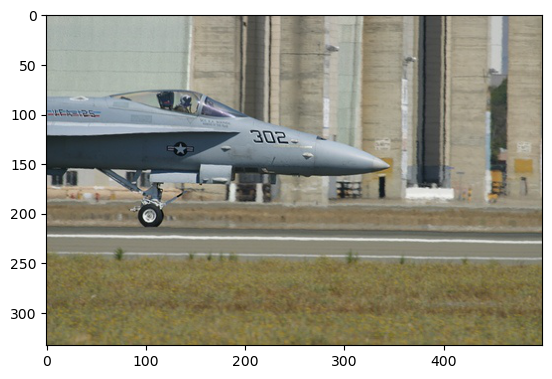

In [23]:
# taking a sample input image 
sample_img = voc_dataset_val[1572][0]
sample_img = np.array(sample_img)
plt.imshow(sample_img)
plt.show()

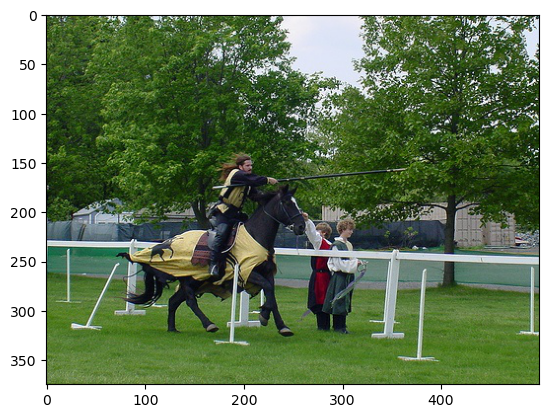

In [212]:
# taking a sample input image 
sample_img = voc_dataset_val[2][0]
sample_img = np.array(sample_img)
plt.imshow(sample_img)
plt.show()

In [214]:
#  defining a function to process the input image for inference 
from torchvision import transforms
def process_input_rcnn(sample_img, max_selections=300):
    # size of the input image of CNN
    section_size=(224, 224)
    images = []
    org_boxes = []
    
    # defining the data transform
    img_transform = transforms.Compose([
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
    # applying selective search to get region proposals for test image
    ss = cv2.ximgproc.segmentation.createSelectiveSearchSegmentation()
    ss.setBaseImage(sample_img)
    ss.switchToSelectiveSearchFast()
    rects = ss.process()[:max_selections]
    rects = np.array([[x, y, x+w, y+h] for x, y, w, h in rects])
    
    for rect in rects:
        x1, y1, x2, y2 = rect
        img_section = sample_img[y1: y2, x1: x2]
        img_section = cv2.resize(img_section, section_size)
        images.append(img_section)
        org_boxes.append(rect)
        
    images = np.array(images, dtype=np.float32)
    images = torch.from_numpy(images)
    images = images.permute(0, 3, 1, 2)
    images = img_transform(images)
    bboxes = np.array(org_boxes)
    return images, bboxes

# check the function 
rgn_proposals, true_boxes = process_input_rcnn(sample_img, max_selections=100)
print(f"Region proposals shape: {rgn_proposals.shape}")
print(f"Shape of those bounding boxes: {true_boxes.shape}")

Region proposals shape: torch.Size([100, 3, 224, 224])
Shape of those bounding boxes: (100, 4)


In [215]:
#  last version
import numpy as np

def decode_bbox_offsets(proposals, bbox_offsets):
    """
    Decode bounding box offsets to real bounding box values.
    Args:
        proposals (ndarray or list): Proposed regions (x, y, w, h). Can be a single box [4,] or multiple boxes [N, 4].
        bbox_offsets (ndarray or list): Predicted bounding box offsets (dx, dy, dw, dh). Same shape as proposals.
    Returns:
        decoded_boxes (ndarray): Decoded bounding boxes (xmin, ymin, xmax, ymax) in numpy array of shape [N, 4].
    """
    # Ensure inputs are NumPy arrays
    proposals = np.array(proposals)
    bbox_offsets = np.array(bbox_offsets)

    # Check if the input is a single box or multiple boxes
    if proposals.ndim == 1:
        proposals = proposals[np.newaxis, :]  # Convert single box to a batch (1, 4)
    if bbox_offsets.ndim == 1:
        bbox_offsets = bbox_offsets[np.newaxis, :]  # Convert single offset to a batch (1, 4)

    # Extract the components of the proposals and offsets
    pred_x, pred_y, pred_w, pred_h = proposals[:, 0], proposals[:, 1], proposals[:, 2], proposals[:, 3]
    dx, dy, dw, dh = bbox_offsets[:, 0], bbox_offsets[:, 1], bbox_offsets[:, 2], bbox_offsets[:, 3]

    # debugging
    # print("Proposals (x, y, w, h):", pred_x, pred_y, pred_w, pred_h)
    # print("Offsets (dx, dy, dw, dh):", dx, dy, dw, dh)
    # print("Exp(dw):", np.exp(dw))
    # print("Exp(dh):", np.exp(dh))

    # Decode (x, y) from center offset
    decoded_x = pred_x + dx * pred_w
    decoded_y = pred_y + dy * pred_h

    # Decode (w, h) from width and height offset
    decoded_w = pred_w * np.exp(dw)
    decoded_h = pred_h * np.exp(dh)

    # print(f"Decoded values: x:{decoded_x}, y:{decoded_y}, w:{decoded_w}, h:{decoded_h}")

    # Convert back to (xmin, ymin, xmax, ymax)
    xmin = decoded_x - decoded_w / 2
    ymin = decoded_y - decoded_h / 2
    # xmax = decoded_x + decoded_w / 2
    # ymax = decoded_y + decoded_h / 2
    xmax = decoded_w    # it should be devided by 2, but in our encoding we did not devide therefore, here are keeping as it is 
    ymax = decoded_h
    

    # Stack the decoded bounding boxes together (N, 4)
    decoded_boxes = np.stack([xmin, ymin, xmax, ymax], axis=1)

    return decoded_boxes


In [216]:
# now we will pass this sample image to the trained rcnnn model to get the prediction and bounding  box regions 
# movind input to device
rgn_proposals = rgn_proposals.to(device)
pred_model = pred_model.to(device)

pred_model.eval()
with torch.no_grad():
    pred_scores, pred_offsets = pred_model(rgn_proposals)

print(f"Shape of prediction scores: {pred_scores.shape}")
print(f"Shape of predicted bbox offsets: {pred_offsets.shape}")


Shape of prediction scores: torch.Size([100, 21])
Shape of predicted bbox offsets: torch.Size([100, 4])


In [174]:
pred_scores[1]

tensor([  17604.4648,   15335.8379,  141712.2500, -112716.8203, -169684.8594,
          67642.3203,  -85202.9219,  -70020.8359,  -79572.4766,  -18765.0469,
         115725.5000,  -56858.9531,  -70482.0078,  172973.4844, -155866.2031,
         -76462.1641,  -43882.8281,   30346.1387, -166540.7344,  -76035.9844,
          62178.2109], device='cuda:0')

In [175]:
import torch.nn.functional as F
pred = torch.argmax(pred_scores[1])
print(f"using the argmax: {pred}")
r_pred = F.softmax(pred_scores[1], dim=-1)
r_score, r_labels = torch.max(r_pred, dim=-1)

print(f"score: {r_score}, label:{r_labels}")

using the argmax: 13
score: 1.0, label:13


Now, we need to decode the predicted bounding boxes to transform those into proposed bounding box shape.

In [176]:
pred_offsets[1]

tensor([ 0.5867,  0.5959, -0.2046, -0.0054], device='cuda:0')

In [177]:
decoded_bbox = decode_bbox_offsets(
    true_boxes[10],  # Convert to NumPy
    pred_offsets[10].cpu().detach().numpy()  # Convert to NumPy
)

print(f"True Box: {true_boxes[10]}")
print(f"Decoded Box: {decoded_bbox}")

True Box: [ 24 238  78 263]
Decoded Box: [[ 32.89675784 271.00393528  96.94456458 313.31711352]]


In [178]:
true_boxes[1]

array([ 70, 268, 109, 304])

In [137]:
type(true_boxes)

numpy.ndarray

In [ ]:
# define a better NPM

In [217]:
import torch
# from iou import intersection_over_union

def nms(bboxes, iou_threshold, threshold, box_format="corners"):
    """
    Does Non Max Suppression given bboxes

    Parameters:
        bboxes (list): list of lists containing all bboxes with each bboxes
        specified as [class_pred, prob_score, x1, y1, x2, y2]
        iou_threshold (float): threshold where predicted bboxes is correct
        threshold (float): threshold to remove predicted bboxes (independent of IoU) 
        box_format (str): "midpoint" or "corners" used to specify bboxes

    Returns:
        list: bboxes after performing NMS given a specific IoU threshold
    """

    assert type(bboxes) == list

    bboxes = [box for box in bboxes if box[1] > threshold]
    bboxes = sorted(bboxes, key=lambda x: x[1], reverse=True)
    bboxes_after_nms = []

    while bboxes:
        chosen_box = bboxes.pop(0)

        bboxes = [
            box
            for box in bboxes
            if box[0] != chosen_box[0]
            or intersection_over_union(
                torch.tensor(chosen_box[2:]),
                torch.tensor(box[2:]),
                box_format=box_format,
            )
            < iou_threshold
        ]

        bboxes_after_nms.append(chosen_box)

    return bboxes_after_nms

In [218]:
import torch
import torch.nn.functional as F

def process_predictions_2(pred_scores, pred_offsets, proposed_bbox, iou_threshold=0.5, score_threshold=0.5):
    """
    Process the predictions and apply NMS to get final bounding boxes and class labels.
    Args:
        pred_scores (Tensor): The predicted scores (logits) for each bounding box.
        pred_offsets (Tensor): The predicted bounding box offsets (dx, dy, dw, dh).
        proposed_bbox (Tensor): The proposed regions for the bounding boxes.
        iou_threshold (float): IOU threshold for NMS.
        score_threshold (float): Minimum confidence score threshold.
    Returns:
        final_boxes (Tensor): The final bounding boxes after NMS.
        final_labels (Tensor): The final class labels after NMS.
        final_scores (Tensor): The final confidence scores after NMS.
    """
    # Apply softmax to get class probabilities
    prob_scores = F.softmax(pred_scores, dim=-1)
    
    # Get the predicted class labels and their scores
    scores, labels = torch.max(prob_scores, dim=-1)
    scores_np = scores.cpu().detach().numpy()
    labels_np = labels.cpu().detach().numpy()
    pred_offsets_np = pred_offsets.cpu().detach().numpy()
    
    # Decode the predicted bounding box offsets
    decoded_boxes = decode_bbox_offsets(proposed_bbox, pred_offsets_np)
    decoded_boxes_trc = torch.from_numpy(decoded_boxes).to(torch.float32)

    # Apply NMS for filtering overlapping boxes
    final_boxes, final_scores = non_max_supression_3(decoded_boxes_trc, scores.cpu(), labels.cpu(), threshold= score_threshold, iou_threshold=iou_threshold)
    # final_boxes, final_scores, final_labels = non_max_supression_3(decoded_boxes_trc, scores.cpu(), labels.cpu(), threshold=threshold, iou_threshold=iou_threshold)
    
    
    return final_boxes, final_labels, final_scores


In [245]:
import torch
import torch.nn.functional as F

def process_predictions(pred_scores, pred_offsets, proposed_bbox, iou_threshold=0.5, score_threshold=0.5):
    """
    Process the predictions and apply NMS to get final bounding boxes and class labels.
    Args:
        pred_scores (Tensor): The predicted scores (logits) for each bounding box.
        pred_offsets (Tensor): The predicted bounding box offsets (dx, dy, dw, dh).
        proposed_bbox (Tensor): The proposed regions for the bounding boxes.
        iou_threshold (float): IOU threshold for NMS.
        score_threshold (float): Minimum confidence score threshold.
    Returns:
        final_boxes (Tensor): The final bounding boxes after NMS.
        final_labels (Tensor): The final class labels after NMS.
        final_scores (Tensor): The final confidence scores after NMS.
    """
    # Apply softmax to get class probabilities
    prob_scores = F.softmax(pred_scores, dim=-1)
    
    # Get the predicted class labels and their scores
    scores, labels = torch.max(prob_scores, dim=-1)

    # print(f"Maximum predicted score: {max(scores)}")
    # print(f"Minimum predicted score: {min(scores)}")
    # print(f"Unique predicted labels are: {labels.unique()}")
    
    # Move predictions and ground truth to numpy for easy processing
    pred_offsets_np = pred_offsets.cpu().detach().numpy()
    
    # Decode the predicted bounding box offsets (convert to [xmin, ymin, xmax, ymax])
    decoded_boxes = decode_bbox_offsets(proposed_bbox, pred_offsets_np)
    decoded_boxes_trc = torch.from_numpy(decoded_boxes).to(torch.float32)
    
    # Prepare the list for NMS (class_pred, score, x1, y1, x2, y2)
    nms_bboxes = []
    for i in range(len(decoded_boxes_trc)):
        nms_bboxes.append([labels[i].item(), scores[i].item(), *decoded_boxes_trc[i].cpu().numpy()])
    
    # Convert nms_bboxes to torch tensor
    # nms_bboxes_tensor = torch.tensor(nms_bboxes, dtype=torch.float32)
    # print(type(nms_bboxes))
    # nms_bboxes_list = nms_bboxes.cpu().detach().numpy().tolist()

    # Apply NMS for filtering overlapping boxes
    final_bboxes = nms(nms_bboxes, iou_threshold=iou_threshold, threshold=score_threshold, box_format="corners")
    
    # Extract final bounding boxes, labels, and scores from NMS output
    final_boxes = torch.tensor([box[2:] for box in final_bboxes], dtype=torch.float32)
    final_labels = torch.tensor([box[0] for box in final_bboxes], dtype=torch.int64)
    final_scores = torch.tensor([box[1] for box in final_bboxes], dtype=torch.float32)

    return final_boxes, final_labels, final_scores


In [219]:
import torch
import torch.nn.functional as F

def process_predictions_V3(pred_scores, pred_offsets, proposed_bbox):
    """
    Process the predictions and apply NMS to get final bounding boxes and class labels.
    Args:
        pred_scores (Tensor): The predicted scores (logits) for each bounding box.
        pred_offsets (Tensor): The predicted bounding box offsets (dx, dy, dw, dh).
        proposed_bbox (Tensor): The proposed regions for the bounding boxes.
        iou_threshold (float): IOU threshold for NMS.
        score_threshold (float): Minimum confidence score threshold.
    Returns:
        final_boxes (Tensor): The final bounding boxes after NMS.
        final_labels (Tensor): The final class labels after NMS.
        final_scores (Tensor): The final confidence scores after NMS.
    """
    # Apply softmax to get class probabilities
    prob_scores = F.softmax(pred_scores, dim=-1)
    
    # Get the predicted class labels and their scores
    scores, labels = torch.max(prob_scores, dim=-1)
    
    # Move predictions and ground truth to numpy for easy processing
    pred_offsets_np = pred_offsets.cpu().detach().numpy()
    
    # Decode the predicted bounding box offsets (convert to [xmin, ymin, xmax, ymax])
    decoded_boxes = decode_bbox_offsets(proposed_bbox, pred_offsets_np)
    decoded_boxes_trc = torch.from_numpy(decoded_boxes).to(torch.float32)
    return scores, labels, decoded_boxes_trc


In [221]:
y_scores, y_labels, y_boxes = process_predictions_V3(pred_scores, pred_offsets, true_boxes)

In [222]:
# sf_boxes, sf_labels, sf_scores = process_predictions(pred_scores, pred_offsets, true_boxes, iou_threshold=0.7, score_threshold=0.9)
sf_boxes = process_predictions(pred_scores, pred_offsets, true_boxes, iou_threshold=0.7, score_threshold=0.9)

In [223]:
print(type(sf_boxes))
len(sf_boxes)

<class 'list'>


100

In [211]:
def remove_duplicate_labels(sf_boxes):
    """
    Remove duplicate bounding boxes with the same label, keeping the one with the highest score.

    Args:
        sf_boxes (list): List of bounding boxes in the format [label, score, x1, y1, x2, y2]

    Returns:
        list: List of bounding boxes with duplicates removed, keeping the highest score for each label.
    """
    seen_labels = {}
    unique_boxes = []

    for box in sf_boxes:
        label = box[0]
        score = box[1]
        coordinates = box[2:]

        # If the label has been seen before
        if label in seen_labels:
            # Compare the current score with the stored score for this label
            prev_score = seen_labels[label][1]
            if score > prev_score:
                # If current score is higher, update the stored box with the new box
                seen_labels[label] = (coordinates, score)
        else:
            # If the label is new, store the box
            seen_labels[label] = (coordinates, score)

    # Rebuild the list with the boxes having the highest score for each label
    for label, (coords, score) in seen_labels.items():
        unique_boxes.append([label, score] + list(coords))

    return unique_boxes

# Example usage:
d_boxes = [
    [12, 1.0, 456.77017, 178.145, 548.7143, 236.31654],
    [12, 0.95, 427.5388, 1.7106034, 441.43167, 41.71506],  # Duplicate class 12 with lower score
    [2, 1.0, 21.882925, 102.64327, 42.672142, 273.24265],
    [1, 1.0, 45.58989, 127.96797, 67.79481, 211.47594],
    [12, 0.98, 398.90012, 337.1196, 473.49527, 405.24927]   # Duplicate class 12 with lower score
]

# Remove duplicates
unique_sf_boxes = remove_duplicate_labels(d_boxes)

# Print results
for box in unique_sf_boxes:
    print(f"Label: {box[0]}, Score: {box[1]}, Box: {box[2:]}")


Label: 12, Score: 1.0, Box: [456.77017, 178.145, 548.7143, 236.31654]
Label: 2, Score: 1.0, Box: [21.882925, 102.64327, 42.672142, 273.24265]
Label: 1, Score: 1.0, Box: [45.58989, 127.96797, 67.79481, 211.47594]


In [187]:
print(type(sf_scores))
print(f"Shape: {sf_scores.shape}")
print(f"Maximum values: {max(sf_scores)}")
print(F"Minimum value: {min(sf_scores)}")
print(f"Uniques scores are: {sf_scores.unique()}")

<class 'torch.Tensor'>
Shape: torch.Size([50])
Maximum values: 1.0
Minimum value: 1.0
Uniques scores are: tensor([1.])


In [ ]:
#  some post processing 



In [224]:
import numpy as np
import torch
from sklearn.cluster import DBSCAN

def cluster_boxes_by_class(bboxes, labels, scores, overlap_thresh=0.5):
    """
    Cluster bounding boxes that have high overlap and belong to the same class.
    Select the box with the highest score from each cluster.

    Args:
        bboxes (Tensor): A tensor of bounding boxes [x1, y1, x2, y2].
        labels (Tensor): A tensor of class labels.
        scores (Tensor): A tensor of prediction scores.
        overlap_thresh (float): The overlap threshold for clustering.

    Returns:
        List of selected boxes, scores, and labels.
    """

    def iou(box1, box2):
        """Calculate Intersection over Union (IoU) between two boxes."""
        x1, y1, x2, y2 = box1
        xx1, yy1, xx2, yy2 = box2
        
        inter_x1 = max(x1, xx1)
        inter_y1 = max(y1, yy1)
        inter_x2 = min(x2, xx2)
        inter_y2 = min(y2, yy2)
        
        inter_area = max(0, inter_x2 - inter_x1) * max(0, inter_y2 - inter_y1)
        box1_area = (x2 - x1) * (y2 - y1)
        box2_area = (xx2 - xx1) * (yy2 - yy1)
        
        iou_value = inter_area / float(box1_area + box2_area - inter_area)
        return iou_value
    
    selected_bboxes = []
    selected_labels = []
    selected_scores = []

    for class_id in torch.unique(labels):
        # Filter bboxes, scores, and labels for the current class
        class_bboxes = bboxes[labels == class_id]
        class_scores = scores[labels == class_id]
        
        # Sort by score in descending order
        sorted_indices = torch.argsort(class_scores, descending=True)
        class_bboxes = class_bboxes[sorted_indices]
        class_scores = class_scores[sorted_indices]
        
        # Use DBSCAN to cluster boxes based on IoU threshold
        boxes_array = class_bboxes.numpy()
        iou_matrix = np.array([[iou(box1, box2) for box2 in boxes_array] for box1 in boxes_array])
        
        # Apply DBSCAN to group boxes based on IoU threshold
        clustering = DBSCAN(eps=overlap_thresh, min_samples=1, metric="precomputed").fit(1 - iou_matrix)
        labels_cluster = clustering.labels_
        
        # For each cluster, choose the box with the highest score
        for cluster_id in np.unique(labels_cluster):
            cluster_indices = np.where(labels_cluster == cluster_id)[0]
            cluster_bboxes = class_bboxes[cluster_indices]
            cluster_scores = class_scores[cluster_indices]
            
            # Select the box with the highest score
            best_box_index = cluster_indices[torch.argmax(cluster_scores)]
            selected_bboxes.append(class_bboxes[best_box_index])
            selected_scores.append(class_scores[best_box_index])
            selected_labels.append(class_id)

    return selected_bboxes, selected_labels, selected_scores


# definng data
final_boxes = torch.tensor([box[2:] for box in sf_boxes], dtype=torch.float32)
final_labels = torch.tensor([box[0] for box in sf_boxes], dtype=torch.int64)
final_scores = torch.tensor([box[1] for box in sf_boxes], dtype=torch.float32)

# Cluster the boxes by class and pick the best box per cluster
selected_bboxes, selected_labels, selected_scores = cluster_boxes_by_class(final_boxes,final_labels, final_scores, overlap_thresh=0.5)
# selected_bboxes, selected_labels, selected_scores = cluster_boxes_by_class(y_boxes.cpu(),y_labels.cpu(), y_scores.cpu(), overlap_thresh=0.5)

print("Selected Boxes:", selected_bboxes)
print("Selected Labels:", selected_labels)
print("Selected Scores:", selected_scores)


Selected Boxes: [tensor([190.0982, 155.9536, 217.6445, 236.1712]), tensor([272.5368, 113.8534, 420.6950, 245.3782]), tensor([457.1145, 199.4201, 680.8997, 375.7167]), tensor([ 20.7699, 208.2249, 175.3817, 282.2086]), tensor([376.8552, 258.4393, 401.6571, 293.5477]), tensor([288.3029, 222.1801, 360.4102, 297.7874]), tensor([181.7523,   0.5381, 330.8425,  77.9393]), tensor([239.3324, 230.7913, 237.7733, 321.0855]), tensor([ 48.0393, 108.3656,  63.7295, 161.9525]), tensor([127.4174, 292.6375, 175.9494, 394.3683]), tensor([ 77.0904, 289.0813,  83.2464, 315.4305]), tensor([421.4414,   1.6868, 579.4272,  43.3960]), tensor([ 50.1282, 414.8702,  66.6765, 426.5303]), tensor([378.0843,  49.5737, 396.9549,  80.7230]), tensor([4.8426e+02, 4.9255e-01, 5.3243e+02, 1.8777e+01]), tensor([ 95.7456, 253.2098, 210.8697, 292.9742]), tensor([125.3378, 227.6245, 127.8174, 291.7172]), tensor([262.8298, 290.8231, 306.1727, 329.0256]), tensor([514.2968, 237.6813, 609.7391, 307.7427]), tensor([177.1158, 163.823

In [225]:
# approach-1 
print(f"Total boxes in selected bboxes: {len(selected_bboxes)}")
print(f"Total boxes in selected labels: {len(selected_labels)}")
print(f"Total boxes in selected bboxes: {len(selected_scores)}")

Total boxes in selected bboxes: 68
Total boxes in selected labels: 68
Total boxes in selected bboxes: 68


In [226]:
# approach -2
unique_pred_boxes = remove_duplicate_labels(sf_boxes)

In [227]:
# Print results
for box in unique_pred_boxes:
    print(f"Label: {box[0]}, Score: {box[1]}, Box: {box[2:]}")

Label: 2, Score: 1.0, Box: [239.33243, 230.79126, 237.77327, 321.08554]
Label: 12, Score: 1.0, Box: [383.96683, 314.14337, 335.00027, 369.2801]
Label: 1, Score: 1.0, Box: [190.09819, 155.95355, 217.64455, 236.17122]
Label: 13, Score: 1.0, Box: [132.08386, 165.46097, 138.28336, 184.51451]
Label: 5, Score: 1.0, Box: [6.5917983, -4.1804175, 135.98451, 65.71896]
Label: 10, Score: 1.0, Box: [5.691979, 272.31473, 26.017366, 258.9087]
Label: 20, Score: 1.0, Box: [181.23912, 174.93591, 194.89575, 237.70775]


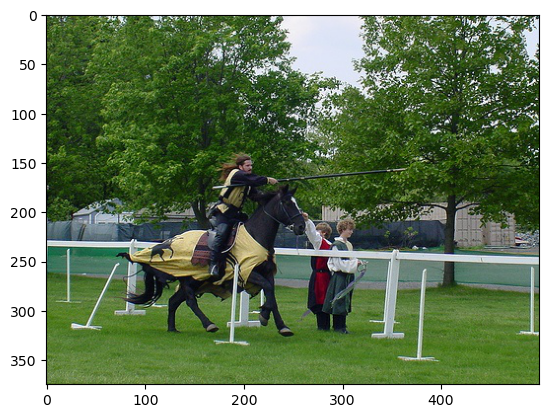

In [229]:
approach_1 = sample_img
appraoch_2 = sample_img
plt.imshow(approach_1)
plt.show()

In [230]:
def draw_boxes_33(img, boxes, scores, labels, class_map=None):
    nums = len(boxes)
    for i in range(nums):
        x1y1 = tuple((np.array(boxes[i][0:2])).astype(np.int32))
        x2y2 = tuple((np.array(boxes[i][2:4])).astype(np.int32))
        img = cv2.rectangle(img, x1y1, x2y2, (255, 0, 0), 2)
        label = int(labels[i])
        if class_map is not None:
            label_txt = class_map[label]
        else:
            label_txt = str(label)
        img = cv2.putText(
            img,
            "{} {:.4f}".format(label_txt, scores[i]),
            x1y1,
            cv2.FONT_HERSHEY_COMPLEX_SMALL,
            1,
            (0, 0, 255),
            2,
        )
    return img

In [242]:
type(selected_bboxes[0])

torch.Tensor

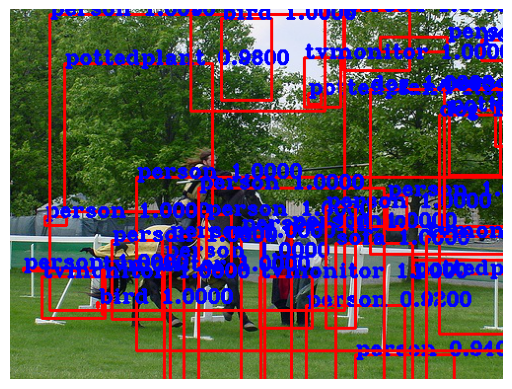

In [208]:
final_image = draw_boxes_33(sample_img,
                         selected_bboxes,
                         selected_scores,
                         selected_labels,
                         idx_to_obj)
plt.axis("off")
plt.imshow(final_image)
plt.show()

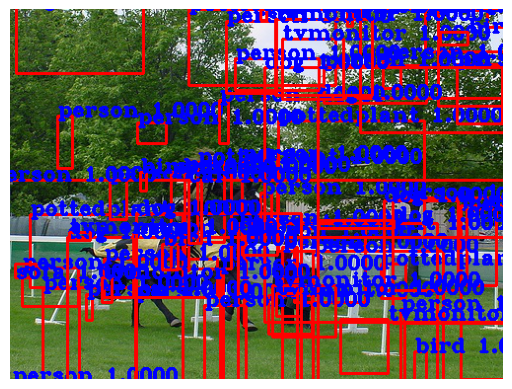

In [232]:
# visulaization with appraoch-1
final_image = draw_boxes_33(approach_1,
                         selected_bboxes,
                         selected_scores,
                         selected_labels,
                         idx_to_obj)
plt.axis("off")
plt.imshow(final_image)
plt.show()

In [233]:
unique_pred_boxes

[[2, 1.0, 239.33243, 230.79126, 237.77327, 321.08554],
 [12, 1.0, 383.96683, 314.14337, 335.00027, 369.2801],
 [1, 1.0, 190.09819, 155.95355, 217.64455, 236.17122],
 [13, 1.0, 132.08386, 165.46097, 138.28336, 184.51451],
 [5, 1.0, 6.5917983, -4.1804175, 135.98451, 65.71896],
 [10, 1.0, 5.691979, 272.31473, 26.017366, 258.9087],
 [20, 1.0, 181.23912, 174.93591, 194.89575, 237.70775]]

In [243]:
# Extract labels (index 0)
u_labels = torch.tensor([box[0] for box in unique_pred_boxes])

# Extract scores (index 1)
u_scores = torch.tensor([box[1] for box in unique_pred_boxes])

# Extract bounding boxes (index 2 and onward)
u_boxes = torch.tensor([box[2:] for box in unique_pred_boxes])


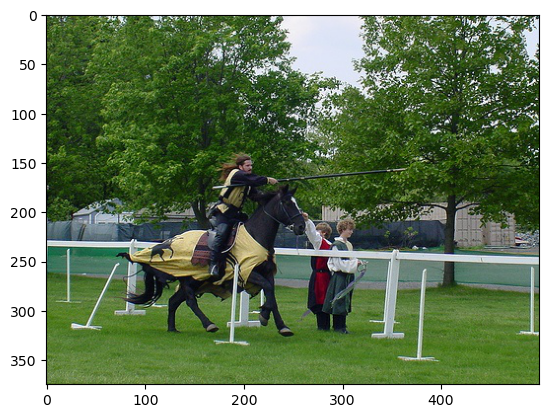

In [238]:
plt.imshow(voc_dataset_val[2][0])
plt.show()

In [252]:
import cv2
import numpy as np
from PIL import Image

def draw_boxes_on_image_f(image, boxes, labels, scores, obj_to_idx, score_threshold=0.5):
    """
    Draw bounding boxes on the image with class labels and confidence scores.
    Args:
        image (ndarray): The input image to draw the bounding boxes on.
        boxes (Tensor): The predicted bounding boxes (xmin, ymin, xmax, ymax).
        labels (Tensor): The predicted class labels (indices from obj_to_idx).
        scores (Tensor): The confidence scores for each prediction.
        obj_to_idx (dict): Mapping of class names to indices.
        score_threshold (float): Minimum score threshold to display the boxes.
    Returns:
        image (ndarray): The image with the drawn bounding boxes.
    """
    # Convert the image to the format compatible with OpenCV (if necessary)
    if isinstance(image, Image.Image):
        image = np.array(image)
        
    image = image.astype(np.uint8)

    for i in range(len(boxes)):
        # Only draw boxes with a score above the threshold
        if scores[i] > score_threshold:
            xmin, ymin, xmax, ymax = boxes[i].cpu().numpy()

            # Get the class name using the label index from obj_to_idx
            label_idx = labels[i].item()  # Convert tensor to Python number
            class_name = [key for key, value in obj_to_idx.items() if value == label_idx][0]

            # Draw the bounding box and label on the image
            color = (0, 255, 0)  # Green color for the box
            thickness = 2
            cv2.rectangle(image, (int(xmin), int(ymin)), (int(xmax), int(ymax)), color, thickness)

            # Label text
            label_text = f'{class_name}: {scores[i]:.2f}'
            font = cv2.FONT_HERSHEY_SIMPLEX
            font_scale = 0.5
            font_thickness = 1
            cv2.putText(image, label_text, (int(xmin), int(ymin)-10), font, font_scale, color, font_thickness)

    return image


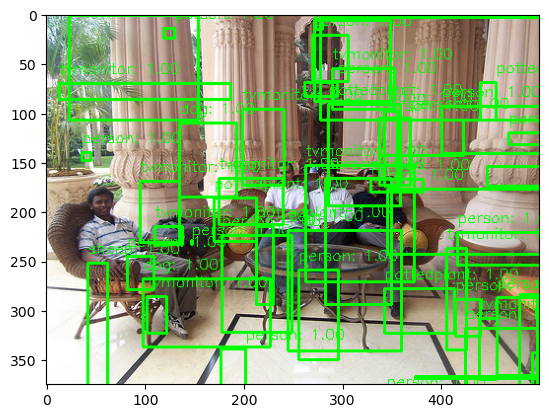

In [253]:
# PUTTING ALTOGETHER
# FUNCTION TO GET PREDCITED BOUNDING BOX
max_regions = 50
iou_threshold=0.65
score_threshold=0.8
img = voc_dataset_val[223][0]

def get_bounding_box_img(model, img, max_regions, iou_threshold=0.5, score_threshold=0.6):
    # create proposed regions
    rgn_proposals, true_boxes = process_input_rcnn(sample_img, max_selections=max_regions)
    
    rgn_proposals = rgn_proposals.to(device)
    model = model.to(device)

    # prediction pass
    model.eval()
    with torch.no_grad():
        pred_scores, pred_offsets = model(rgn_proposals)

    # getting final boxes, labels and scores
    f_boxes, f_labels, f_scores = process_predictions(pred_scores, pred_offsets, true_boxes, iou_threshold=iou_threshold, score_threshold=score_threshold)
    
    final_img = draw_boxes_on_image_f(img, f_boxes, f_labels, f_scores, obj_to_idx, score_threshold=score_threshold)
    return final_img 

# use case 
p_img = get_bounding_box_img(pred_model, img, max_regions, iou_threshold=iou_threshold, score_threshold=score_threshold)
plt.imshow(p_img)
plt.show()

In [ ]:
#  sample use case of the initial version 

# load a validation image
val_image = np.array(voc_dataset_val[0][0])
# preprocess input image
prep_val_images, prep_val_boxes = process_inputs(val_image)
prep_val_images.shape, prep_val_images.dtype, prep_val_boxes.shape, prep_val_boxes.dtype

#### Draft

In [67]:
# Function to test the evaluation on a small subset of the validation loader
def test_with_small_subset(model, valid_loader, criterion, device, evaluate_fn, num_batches=3):
    model.eval()  # Set the model to evaluation mode
    subset_batches = []  # Container for the small subset of batches

    # Extract the first `num_batches` from the validation loader
    for batch_idx, batch_data in enumerate(valid_loader):
        if batch_idx >= num_batches:
            break
        subset_batches.append(batch_data)

    # Pass the small subset through the evaluation function
    for batch_idx, batch_data in enumerate(subset_batches):
        images, class_labels, bbox_targets = batch_data

        images = images.to(device)
        class_labels = class_labels.to(device)
        bbox_targets = [
            b.clone().detach().to(device).float() if isinstance(b, torch.Tensor) else b
            for b in bbox_targets
        ]

        # Ensure all data is moved to the correct device and processed correctly
        print(f"Evaluating batch {batch_idx + 1}/{len(subset_batches)}...")
        val_loss, val_accuracy, val_mean_iou, val_map = evaluate_fn(
            model, [(images, class_labels, bbox_targets)], criterion, device
        )
        print(
            f"Batch {batch_idx + 1} - Loss: {val_loss}, Accuracy: {val_accuracy:.2f}%, "
            f"Mean IoU: {val_mean_iou:.4f}, mAP: {val_map:.4f}"
        )

# Example Usage:
criterion = RCNNWithBBoxLoss()
test_with_small_subset(
    model=rcnn_bbox_model,
    valid_loader=valid_loader,
    criterion=criterion,
    device=device,
    evaluate_fn=evaluate,  # Your pre-defined evaluation function
    num_batches=3  # Test with 3 batches
)


Evaluating batch 1/3...
Batch 1 - Loss: 0.11662442237138748, Accuracy: 100.00%, Mean IoU: 0.0000, mAP: 0.0000
Evaluating batch 2/3...
Batch 2 - Loss: 0.12106221914291382, Accuracy: 100.00%, Mean IoU: 0.0000, mAP: 0.0000
Evaluating batch 3/3...
Batch 3 - Loss: 0.10264642536640167, Accuracy: 100.00%, Mean IoU: 0.0000, mAP: 0.0000


In [41]:
import torch
from torchmetrics.detection.mean_ap import MeanAveragePrecision

# Create dummy model for testing
class DummyRCNNModel(torch.nn.Module):
    def __init__(self):
        super(DummyRCNNModel, self).__init__()
        self.fc = torch.nn.Linear(3*224*224, 2)  # Just a dummy model with 2 classes (no real object detection)

    def forward(self, x):
        # Simulating outputs for bounding boxes and class scores
        class_scores = torch.softmax(self.fc(x.view(x.size(0), -1)), dim=1)
        bbox_offsets = torch.rand(x.size(0), 4)  # Dummy bbox offsets
        return class_scores, bbox_offsets

# Simulate some dummy data
def generate_dummy_data(batch_size=2):
    # Dummy images (batch_size x 3 x 224 x 224), random values for the purpose of testing
    images = torch.randn(batch_size, 3, 224, 224)
    # Dummy ground truth class labels (batch_size)
    class_labels = torch.tensor([1, 0])  # Example: 1 for class 1 and 0 for class 0
    # Dummy bounding box targets (batch_size x 4) [xmin, ymin, xmax, ymax]
    bbox_targets = torch.tensor([[50, 50, 150, 150], [30, 30, 120, 120]], dtype=torch.float32)
    return images, class_labels, bbox_targets

# Test function to verify the mAP calculation
def test_map_calculation():
    model = DummyRCNNModel().to(device)
    model.eval()  # Set model to evaluation mode
    
    # Create a MeanAveragePrecision metric instance
    map_metric = MeanAveragePrecision()

    # Generate dummy data
    images, class_labels, bbox_targets = generate_dummy_data(batch_size=2)

    # Move data to the same device as the model
    images, class_labels, bbox_targets = images.to(device), class_labels.to(device), bbox_targets.to(device)
    
    # Perform a forward pass through the model
    with torch.no_grad():
        class_scores, bbox_offsets = model(images)

    # Update mAP Metric
    for idx in range(len(class_labels)):
        map_metric.update(
            preds=[{
                "boxes": bbox_offsets[idx].unsqueeze(0),  # Predicted boxes
                "scores": class_scores[idx, 1].unsqueeze(0),  # Predicted scores for class 1 (confidence)
                "labels": class_labels[idx].unsqueeze(0)  # Predicted labels
            }],
            target=[{
                "boxes": bbox_targets[idx].unsqueeze(0),  # Ground truth boxes
                "labels": class_labels[idx].unsqueeze(0)  # Ground truth labels
            }]
        )

    # Compute mAP
    map_result = map_metric.compute()
    overall_map = map_result['map'].item() 

    
    print("mAP result:", map_result)
    print("mAP overall:", overall_map)

# Run the test
test_map_calculation()


mAP result: {'map': tensor(0.), 'map_50': tensor(0.), 'map_75': tensor(0.), 'map_small': tensor(-1.), 'map_medium': tensor(0.), 'map_large': tensor(0.), 'mar_1': tensor(0.), 'mar_10': tensor(0.), 'mar_100': tensor(0.), 'mar_small': tensor(-1.), 'mar_medium': tensor(0.), 'mar_large': tensor(0.), 'map_per_class': tensor(-1.), 'mar_100_per_class': tensor(-1.), 'classes': tensor([0, 1], dtype=torch.int32)}
mAP overall: 0.0


In [120]:
for i, (images, class_labels, bbox_targets) in enumerate(train_loader):
    if i == 2:  # Break after processing two iterations
        break
    print(f"Iteration {i}:")
    print(f"Type of images: {type(images)}")
    print(f"Type of class_labels: {type(class_labels)}")
    print(f"Type of bbox_targets: {type(bbox_targets)}")
    print(len(bbox_targets))


Iteration 0:
Type of images: <class 'torch.Tensor'>
Type of class_labels: <class 'torch.Tensor'>
Type of bbox_targets: <class 'list'>
4
Iteration 1:
Type of images: <class 'torch.Tensor'>
Type of class_labels: <class 'torch.Tensor'>
Type of bbox_targets: <class 'list'>
4


In [ ]:


# Assuming you have your RCNNWithBBox model defined already
model = RCNNWithBBox(backbone=fine_tuned_resnet, num_classes=num_classes)

# Set device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model.to(device)

# Loss function
classification_loss_fn = torch.nn.CrossEntropyLoss()
regression_loss_fn = torch.nn.MSELoss()

# Optimizer
optimizer = optim.SGD(model.parameters(), lr=0.001, momentum=0.9)

# Training loop
epochs = 10
for epoch in range(epochs):
    model.train()
    running_loss = 0.0
    for images, labels, bbox_targets in train_loader:
        images = images.to(device)
        labels = labels.to(device)
        bbox_targets = bbox_targets.to(device)

        # Zero the parameter gradients
        optimizer.zero_grad()

        # Forward pass
        class_scores, bbox_offsets = model(images)

        # Compute classification loss
        classification_loss = classification_loss_fn(class_scores, labels)

        # Compute bounding box regression loss
        regression_loss = regression_loss_fn(bbox_offsets, bbox_targets)

        # Total loss
        loss = classification_loss + regression_loss

        # Backward pass and optimize
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

    print(f"Epoch [{epoch+1}/{epochs}], Loss: {running_loss/len(train_loader):.4f}")


In [ ]:
class CustomModel(nn.Module):
    def __init__(self, backbone, num_classes):
        super(CustomModel, self).__init__()
        self.backbone = backbone
        num_ftrs = 2048 * 7 * 7  # Output of layer4 is [batch_size, 2048, 7, 7], so num_ftrs = 2048 * 7 * 7
        # Update the classifier to match the new number of input features
        self.classifier = nn.Sequential(
            nn.Dropout(0.25),
            nn.Linear(num_ftrs, 512),  # Modify this to match the flattened size
            nn.Dropout(0.25),
            nn.Linear(512, num_classes + 1)
        )
        self.regressor = BoundingBoxRegressor(input_dim=num_ftrs, output_dim=4)  # Bounding box regressor

    def forward(self, x):
        # Pass through the ResNet backbone (up to layer4)
        x = self.backbone.conv1(x)
        x = self.backbone.bn1(x)
        x = self.backbone.relu(x)
        x = self.backbone.maxpool(x)
        
        x = self.backbone.layer1(x)
        x = self.backbone.layer2(x)
        x = self.backbone.layer3(x)
        x = self.backbone.layer4(x)  # This outputs [batch_size, 2048, 7, 7]
        print("Shape after layer4:", x.shape)
        
        # Flatten the output of layer4
        x = x.view(x.size(0), -1)  # Flatten to [batch_size, 2048 * 7 * 7]
        print("Flattened shape:", x.shape)
        
        # Perform classification using the custom classifier
        class_scores = self.classifier(x)  # Now passing flattened x to classifier
        
        # Perform bounding box regression
        bbox_offsets = self.regressor(x)  # Using flattened x for bounding box regression
        
        return class_scores, bbox_offsets

# Example input tensor with batch size = 1 and input size = 224x224 (standard ResNet input size)
demo_input = torch.randn(1, 3, 224, 224).to(device)

# Instantiate the model with the pre-trained backbone
d_model = CustomModel(backbone=backbone_model, num_classes=20)
d_model.to(device)
class_scores, bbox_offsets = d_model(demo_input)

print("Class scores:", class_scores.shape)
print("Bounding box offsets:", bbox_offsets.shape)


In [ ]:
# 
import numpy as np
import torch

def decode_bbox(pred_bbox, anchor_bbox):
    """
    Decode the predicted bounding box using the regression offsets and anchor box.
    
    Args:
        pred_bbox (Tensor): Predicted bounding box offsets [dx, dy, dw, dh]
        anchor_bbox (Tensor): The corresponding anchor bounding box [x, y, w, h]
        
    Returns:
        decoded_bbox (Tensor): Decoded bounding box [xmin, ymin, xmax, ymax]
    """
    # Unpack predicted bounding box and anchor box
    pred_dx, pred_dy, pred_dw, pred_dh = pred_bbox
    anchor_x, anchor_y, anchor_w, anchor_h = anchor_bbox
    
    # Decode the predicted center (x', y') and size (w', h')
    pred_x = pred_dx * anchor_w + anchor_x
    pred_y = pred_dy * anchor_h + anchor_y
    pred_w = torch.exp(pred_dw) * anchor_w
    pred_h = torch.exp(pred_dh) * anchor_h
    
    # Convert from (x, y, w, h) to (xmin, ymin, xmax, ymax)
    xmin = pred_x - pred_w / 2
    ymin = pred_y - pred_h / 2
    xmax = pred_x + pred_w / 2
    ymax = pred_y + pred_h / 2
    
    # Return the decoded bounding box
    return torch.stack([xmin, ymin, xmax, ymax], dim=-1)

# Example usage
# pred_bbox: predicted offsets (dx, dy, dw, dh)
# anchor_bbox: anchor box (x, y, w, h) - usually generated from the feature map/grid cell

pred_bbox = torch.tensor([0.1, 0.2, 0.05, 0.03])  # Example predicted offsets
anchor_bbox = torch.tensor([50, 50, 200, 200])  # Example anchor box

decoded_bbox = decode_bbox(pred_bbox, anchor_bbox)
print(decoded_bbox)
